In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sn
from sklearn.linear_model import ElasticNet
import matplotlib.cm as cm
import logging
from pathlib import Path
import os

In [16]:
# data = pd.read_parquet('/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/total_dataset_tech.parquet')
data = pd.read_parquet('/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/total_dataset_tech_org.parquet')

columns = list(data.columns)
columns.insert(1, columns.pop(columns.index('m_category')))
data = data[columns]

data_index = data.groupby(['m_category', 'Ticker', 'date', 'cp_flag']).mean().replace(np.nan, 0)

#Change the dataformat of trading_days_till_exp to tau

data['tau'] = data['lag_trading_days'] / 252

# # Columns to be dropped
columns_to_drop = ['trading_days_till_exp','m_category']
# columns_to_drop = ['prev_day_iv','trading_days_till_exp','moneyness', 'tau', 'lag_trading_days']

data = data.drop(columns=columns_to_drop)
# Assuming 'data' is your DataFrame

print(data.head())

#All traindata
# data = data[data['Ticker'] =='TSLA']

# Drop the specific date from the dataset
data = data[data['Ticker'] != 'TSLA']

# data = data[data['date'] != '2020-03-19']

# Filter the data for dates greater than or equal to '2021-01-01'
testdata = data[data['date'] >= '2021-01-01']


# testdata = testdata.drop(columns=columns_to_drop)
data = data[data['date'] < '2021-01-01']
data.reset_index(drop=True, inplace=True)

  cp_flag Ticker       date  moneyness  impl_volatility         T  \
0       C   AAPL 2019-01-02     -2.402         1.056092  0.011905   
1       C   AAPL 2019-01-02     -2.220         0.621356  0.011905   
2       C   AAPL 2019-01-02     -2.039         0.874640  0.011905   
3       C   AAPL 2019-01-02     -1.860         0.851843  0.011905   
4       C   AAPL 2019-01-02     -1.682         0.596236  0.011905   

   prev_day_iv  prev2_day_iv        PRC  PRC_actual  ...   ms  baspread  \
0          0.0           0.0  157.74001   39.435003  ...  6.0  0.027847   
1          0.0           0.0  157.74001   39.435003  ...  6.0  0.027847   
2          0.0           0.0  157.74001   39.435003  ...  6.0  0.027847   
3          0.0           0.0  157.74001   39.435003  ...  6.0  0.027847   
4          0.0           0.0  157.74001   39.435003  ...  6.0  0.027847   

            ill    maxret    retvol  std_dolvol  std_turn     zerotrade  sic2  \
0  2.548018e-12  0.040515  0.027893    0.344719  3.36

In [17]:
data

,cp_flag,Ticker,date,moneyness,impl_volatility,T,prev_day_iv,prev2_day_iv,PRC,PRC_actual,...,ms,baspread,ill,maxret,retvol,std_dolvol,std_turn,zerotrade,sic2,tau
0,C,AAPL,2019-01-02,-2.402,1.056092,0.011905,0.000000,0.000000,157.74001,39.435003,...,6.0,0.027847,2.548018e-12,0.040515,0.027893,0.344719,3.369334,1.040351e-08,36.0,0.011905
1,C,AAPL,2019-01-02,-2.220,0.621356,0.011905,0.000000,0.000000,157.74001,39.435003,...,6.0,0.027847,2.548018e-12,0.040515,0.027893,0.344719,3.369334,1.040351e-08,36.0,0.011905
2,C,AAPL,2019-01-02,-2.039,0.874640,0.011905,0.000000,0.000000,157.74001,39.435003,...,6.0,0.027847,2.548018e-12,0.040515,0.027893,0.344719,3.369334,1.040351e-08,36.0,0.011905
3,C,AAPL,2019-01-02,-1.860,0.851843,0.011905,0.000000,0.000000,157.74001,39.435003,...,6.0,0.027847,2.548018e-12,0.040515,0.027893,0.344719,3.369334,1.040351e-08,36.0,0.011905
4,C,AAPL,2019-01-02,-1.682,0.596236,0.011905,0.000000,0.000000,157.74001,39.435003,...,6.0,0.027847,2.548018e-12,0.040515,0.027893,0.344719,3.369334,1.040351e-08,36.0,0.011905
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184396,P,NVDA,2020-12-31,0.772,0.315761,0.023810,0.264673,0.251837,525.83002,131.457505,...,6.0,0.036043,4.251470e-12,0.059507,0.031268,0.316962,4.756248,7.141014e-09,36.0,0.023810
184397,P,NVDA,2020-12-31,0.871,0.321187,0.023810,0.246925,0.285140,525.83002,131.457505,...,6.0,0.036043,4.251470e-12,0.059507,0.031268,0.316962,4.756248,7.141014e-09,36.0,0.023810
184398,P,NVDA,2020-12-31,0.969,0.330034,0.023810,0.235908,0.286806,525.83002,131.457505,...,6.0,0.036043,4.251470e-12,0.059507,0.031268,0.316962,4.756248,7.141014e-09,36.0,0.023810
184399,P,NVDA,2020-12-31,1.164,0.333090,0.023810,0.305504,0.272056,525.83002,131.457505,...,6.0,0.036043,4.251470e-12,0.059507,0.031268,0.316962,4.756248,7.141014e-09,36.0,0.023810


In [18]:
# Add some filters for Deep ITM options:

# # Filter for call options ('C') where moneyness > -0.5
# data = data[(data["cp_flag"] == 'C') & (data['moneyness'] > -0.5)]

# # Filter for put options ('P') where moneyness < 0.5
# data = data[(data["cp_flag"] == 'P') & (data['moneyness'] < 0.5)]

# The above two operations will leave an empty DataFrame, so we should combine them properly.
# Combining the two conditions to filter both calls and puts correctly:
data = data[((data["cp_flag"] == 'C') & (data['moneyness'] > -0.5)) | 
            ((data["cp_flag"] == 'P') & (data['moneyness'] < 0.5))]

data.sort_values(by=['impl_volatility'], inplace=True)
data


/var/folders/b4/wn87d6495j1_vytb8m33q3mm0000gn/T/ipykernel_97868/3874039479.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.sort_values(by=['impl_volatility'], inplace=True)


,cp_flag,Ticker,date,moneyness,impl_volatility,T,prev_day_iv,prev2_day_iv,PRC,PRC_actual,...,ms,baspread,ill,maxret,retvol,std_dolvol,std_turn,zerotrade,sic2,tau
33641,C,AMZN,2019-11-26,0.059,0.071591,0.011905,0.145194,0.137430,1773.83997,88.691998,...,7.0,0.015478,1.652483e-12,0.018284,0.010159,0.341193,3.062671,1.351473e-08,59.0,0.011905
75586,C,MSFT,2019-11-27,0.438,0.075950,0.007937,0.000000,0.000000,152.03000,152.030000,...,6.0,0.015126,3.229663e-12,0.024160,0.012672,0.247415,0.802425,2.648591e-08,73.0,0.007937
162732,P,MSFT,2019-03-05,0.224,0.076044,0.015873,0.226705,0.181672,112.26000,112.260000,...,6.0,0.019346,3.939662e-12,0.043456,0.018340,0.205383,0.966841,2.504067e-08,73.0,0.015873
97862,P,AAPL,2019-11-26,-0.297,0.078515,0.011905,0.206439,0.182470,266.37000,66.592500,...,6.0,0.017041,1.651022e-12,0.028421,0.013497,0.263848,1.679837,1.403277e-08,36.0,0.011905
1670,C,AAPL,2019-07-03,-0.167,0.085859,0.007937,0.000000,0.000000,202.73000,50.682500,...,6.0,0.021222,2.290417e-12,0.047191,0.020082,0.294573,2.205002,1.345086e-08,36.0,0.007937
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157409,P,META,2020-03-19,-2.076,2.674747,0.007937,1.375467,1.402500,146.96001,146.960010,...,8.0,0.020897,3.838376e-12,0.026630,0.019822,0.328264,2.989747,1.629107e-08,73.0,0.007937
176722,P,NVDA,2020-03-19,-2.385,2.705215,0.007937,2.235513,2.008283,202.82001,50.705002,...,5.0,0.034620,8.193293e-12,0.056008,0.032593,0.477481,8.775282,6.103507e-09,36.0,0.007937
157405,P,META,2020-03-19,-2.447,2.725074,0.007937,1.375467,1.402500,146.96001,146.960010,...,8.0,0.020897,3.838376e-12,0.026630,0.019822,0.328264,2.989747,1.629107e-08,73.0,0.007937
176706,P,NVDA,2020-03-18,0.491,2.782026,0.011905,1.515265,1.531738,217.27000,54.317500,...,5.0,0.034017,8.165780e-12,0.054825,0.031907,0.463664,8.464299,6.214920e-09,36.0,0.011905


In [19]:
testdata

testdata = testdata[((testdata["cp_flag"] == 'C') & (testdata['moneyness'] > -0.5)) | 
            ((testdata["cp_flag"] == 'P') & (testdata['moneyness'] < 0.5))]

testdata.sort_values(by=['impl_volatility'], inplace=True)
testdata



,cp_flag,Ticker,date,moneyness,impl_volatility,T,prev_day_iv,prev2_day_iv,PRC,PRC_actual,...,ms,baspread,ill,maxret,retvol,std_dolvol,std_turn,zerotrade,sic2,tau
139303,C,MSFT,2021-11-18,-0.356,0.088461,0.007937,0.170868,0.159735,339.12000,339.120000,...,6.0,0.015928,1.217171e-12,0.032613,0.012960,0.310282,1.121536,3.064150e-08,73.0,0.007937
292476,P,AMZN,2021-05-27,-0.231,0.093313,0.007937,0.216586,0.242250,3265.15991,163.257995,...,8.0,0.019164,1.008004e-12,0.022648,0.012250,0.330092,2.739978,1.365479e-08,59.0,0.007937
348350,P,MSFT,2021-05-27,-0.320,0.110425,0.007937,0.183849,0.215570,251.49001,251.490010,...,6.0,0.015003,1.505208e-12,0.027915,0.013536,0.219801,0.922188,2.734372e-08,73.0,0.007937
14204,C,AAPL,2021-08-05,-0.455,0.111421,0.007937,0.210831,0.202955,146.95000,146.950000,...,6.0,0.015353,8.745112e-13,0.024840,0.010480,0.199814,0.932187,2.013764e-08,36.0,0.007937
349158,P,MSFT,2021-09-03,0.241,0.115540,0.019841,0.139407,0.147118,301.14999,301.149990,...,6.0,0.014238,1.018466e-12,0.022605,0.009022,0.200287,0.650222,3.038469e-08,73.0,0.019841
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
372686,P,NVDA,2021-11-04,-1.974,2.350111,0.007937,0.628418,0.646755,265.98001,265.980010,...,6.0,0.024528,2.719661e-12,0.039132,0.019555,0.232078,2.306216,1.044379e-08,36.0,0.007937
372682,P,NVDA,2021-11-04,-2.382,2.361083,0.007937,0.628418,0.646755,265.98001,265.980010,...,6.0,0.024528,2.719661e-12,0.039132,0.019555,0.232078,2.306216,1.044379e-08,36.0,0.007937
372685,P,NVDA,2021-11-04,-2.074,2.361511,0.007937,0.628418,0.646755,265.98001,265.980010,...,6.0,0.024528,2.719661e-12,0.039132,0.019555,0.232078,2.306216,1.044379e-08,36.0,0.007937
372684,P,NVDA,2021-11-04,-2.176,2.434766,0.007937,0.628418,0.646755,265.98001,265.980010,...,6.0,0.024528,2.719661e-12,0.039132,0.019555,0.232078,2.306216,1.044379e-08,36.0,0.007937


In [20]:
data.sort_values(by=['impl_volatility'], inplace=True)
data

/var/folders/b4/wn87d6495j1_vytb8m33q3mm0000gn/T/ipykernel_97868/1732796912.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.sort_values(by=['impl_volatility'], inplace=True)


,cp_flag,Ticker,date,moneyness,impl_volatility,T,prev_day_iv,prev2_day_iv,PRC,PRC_actual,...,ms,baspread,ill,maxret,retvol,std_dolvol,std_turn,zerotrade,sic2,tau
33641,C,AMZN,2019-11-26,0.059,0.071591,0.011905,0.145194,0.137430,1773.83997,88.691998,...,7.0,0.015478,1.652483e-12,0.018284,0.010159,0.341193,3.062671,1.351473e-08,59.0,0.011905
75586,C,MSFT,2019-11-27,0.438,0.075950,0.007937,0.000000,0.000000,152.03000,152.030000,...,6.0,0.015126,3.229663e-12,0.024160,0.012672,0.247415,0.802425,2.648591e-08,73.0,0.007937
162732,P,MSFT,2019-03-05,0.224,0.076044,0.015873,0.226705,0.181672,112.26000,112.260000,...,6.0,0.019346,3.939662e-12,0.043456,0.018340,0.205383,0.966841,2.504067e-08,73.0,0.015873
97862,P,AAPL,2019-11-26,-0.297,0.078515,0.011905,0.206439,0.182470,266.37000,66.592500,...,6.0,0.017041,1.651022e-12,0.028421,0.013497,0.263848,1.679837,1.403277e-08,36.0,0.011905
1670,C,AAPL,2019-07-03,-0.167,0.085859,0.007937,0.000000,0.000000,202.73000,50.682500,...,6.0,0.021222,2.290417e-12,0.047191,0.020082,0.294573,2.205002,1.345086e-08,36.0,0.007937
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157409,P,META,2020-03-19,-2.076,2.674747,0.007937,1.375467,1.402500,146.96001,146.960010,...,8.0,0.020897,3.838376e-12,0.026630,0.019822,0.328264,2.989747,1.629107e-08,73.0,0.007937
176722,P,NVDA,2020-03-19,-2.385,2.705215,0.007937,2.235513,2.008283,202.82001,50.705002,...,5.0,0.034620,8.193293e-12,0.056008,0.032593,0.477481,8.775282,6.103507e-09,36.0,0.007937
157405,P,META,2020-03-19,-2.447,2.725074,0.007937,1.375467,1.402500,146.96001,146.960010,...,8.0,0.020897,3.838376e-12,0.026630,0.019822,0.328264,2.989747,1.629107e-08,73.0,0.007937
176706,P,NVDA,2020-03-18,0.491,2.782026,0.011905,1.515265,1.531738,217.27000,54.317500,...,5.0,0.034017,8.165780e-12,0.054825,0.031907,0.463664,8.464299,6.214920e-09,36.0,0.011905


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


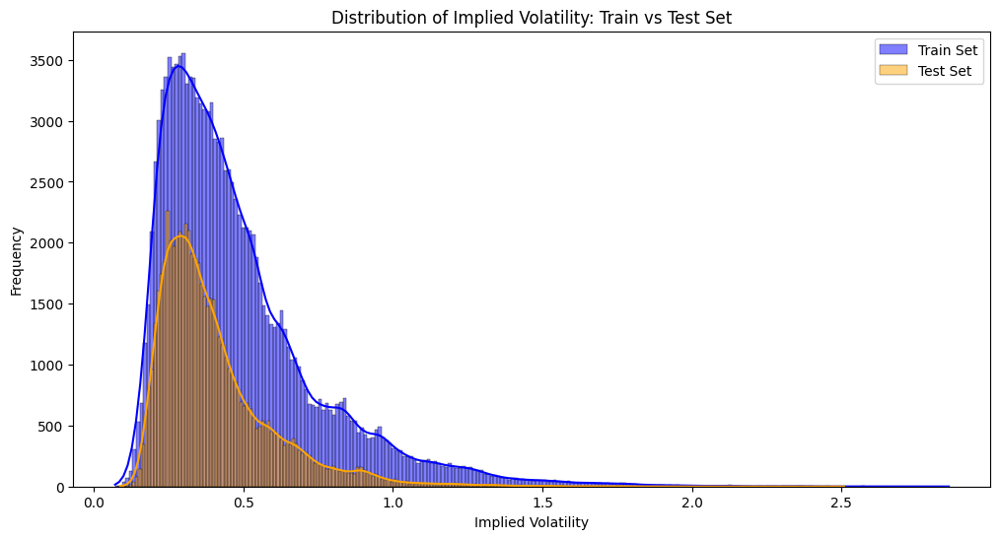

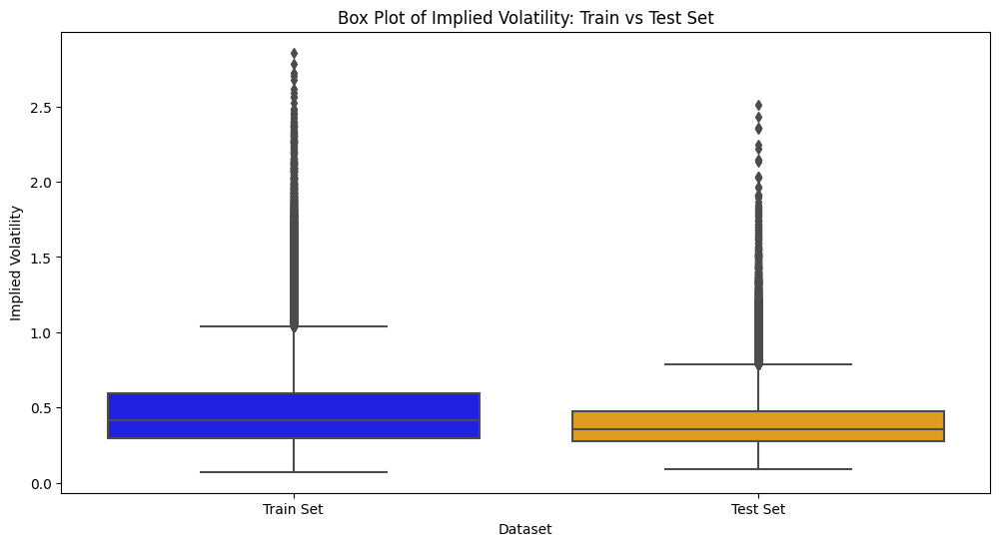

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

# Split into training and test sets
train_data = data
test_data = testdata

# Separate target variable
y_train = data['impl_volatility']
y_test = testdata['impl_volatility']

# Plot histogram of implied volatility for training and test sets
plt.figure(figsize=(12, 6))
sns.histplot(y_train, color='blue', kde=True, label='Train Set')
sns.histplot(y_test, color='orange', kde=True, label='Test Set')
plt.title('Distribution of Implied Volatility: Train vs Test Set')
plt.xlabel('Implied Volatility')
plt.ylabel('Frequency')
plt.legend()
plt.show()

# Plot box plot of implied volatility for training and test sets
plt.figure(figsize=(12, 6))
sns.boxplot(data=[y_train, y_test], palette=['blue', 'orange'])
plt.title('Box Plot of Implied Volatility: Train vs Test Set')
plt.xlabel('Dataset')
plt.ylabel('Implied Volatility')
plt.xticks([0, 1], ['Train Set', 'Test Set'])
plt.show()


In [22]:
data.sort_values(by=['impl_volatility'], inplace=True, ascending=False)
data

/var/folders/b4/wn87d6495j1_vytb8m33q3mm0000gn/T/ipykernel_97868/2555572270.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.sort_values(by=['impl_volatility'], inplace=True, ascending=False)


,cp_flag,Ticker,date,moneyness,impl_volatility,T,prev_day_iv,prev2_day_iv,PRC,PRC_actual,...,ms,baspread,ill,maxret,retvol,std_dolvol,std_turn,zerotrade,sic2,tau
86701,C,NVDA,2020-03-12,2.431,2.858452,0.007937,0.656515,1.292216,246.47000,61.617500,...,5.0,0.030399,8.000700e-12,0.047727,0.027790,0.380761,6.598402,6.883396e-09,36.0,0.007937
176706,P,NVDA,2020-03-18,0.491,2.782026,0.011905,1.515265,1.531738,217.27000,54.317500,...,5.0,0.034017,8.165780e-12,0.054825,0.031907,0.463664,8.464299,6.214920e-09,36.0,0.011905
157405,P,META,2020-03-19,-2.447,2.725074,0.007937,1.375467,1.402500,146.96001,146.960010,...,8.0,0.020897,3.838376e-12,0.026630,0.019822,0.328264,2.989747,1.629107e-08,73.0,0.007937
176722,P,NVDA,2020-03-19,-2.385,2.705215,0.007937,2.235513,2.008283,202.82001,50.705002,...,5.0,0.034620,8.193293e-12,0.056008,0.032593,0.477481,8.775282,6.103507e-09,36.0,0.007937
157409,P,META,2020-03-19,-2.076,2.674747,0.007937,1.375467,1.402500,146.96001,146.960010,...,8.0,0.020897,3.838376e-12,0.026630,0.019822,0.328264,2.989747,1.629107e-08,73.0,0.007937
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1670,C,AAPL,2019-07-03,-0.167,0.085859,0.007937,0.000000,0.000000,202.73000,50.682500,...,6.0,0.021222,2.290417e-12,0.047191,0.020082,0.294573,2.205002,1.345086e-08,36.0,0.007937
97862,P,AAPL,2019-11-26,-0.297,0.078515,0.011905,0.206439,0.182470,266.37000,66.592500,...,6.0,0.017041,1.651022e-12,0.028421,0.013497,0.263848,1.679837,1.403277e-08,36.0,0.011905
162732,P,MSFT,2019-03-05,0.224,0.076044,0.015873,0.226705,0.181672,112.26000,112.260000,...,6.0,0.019346,3.939662e-12,0.043456,0.018340,0.205383,0.966841,2.504067e-08,73.0,0.015873
75586,C,MSFT,2019-11-27,0.438,0.075950,0.007937,0.000000,0.000000,152.03000,152.030000,...,6.0,0.015126,3.229663e-12,0.024160,0.012672,0.247415,0.802425,2.648591e-08,73.0,0.007937


In [23]:
if 'tau' in data.columns:
    print("Column 'moneyness' exists in the DataFrame.")
else:
    print("Column 'moneyness' does not exist in the DataFrame.")

Column 'moneyness' exists in the DataFrame.


In [24]:
data.sort_values(['cp_flag', 'Ticker', 'date'], inplace=True)
testdata.sort_values(['cp_flag', 'Ticker', 'date'], inplace=True)

# data.sort_values(['cp_flag', 'm_category', 'Ticker', 'date'], inplace=True)
# testdata.sort_values(['cp_flag', 'm_category', 'Ticker', 'date'], inplace=True)

/var/folders/b4/wn87d6495j1_vytb8m33q3mm0000gn/T/ipykernel_97868/558515283.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.sort_values(['cp_flag', 'Ticker', 'date'], inplace=True)


In [25]:
data_sortdays = data.sort_values('moneyness')
data_sortdays

,cp_flag,Ticker,date,moneyness,impl_volatility,T,prev_day_iv,prev2_day_iv,PRC,PRC_actual,...,ms,baspread,ill,maxret,retvol,std_dolvol,std_turn,zerotrade,sic2,tau
94990,P,AAPL,2019-01-07,-2.5,0.552315,0.019841,0.511192,0.610028,148.25999,37.064997,...,6.0,0.028801,2.593480e-12,0.045671,0.027927,0.328897,3.332380,1.070499e-08,36.0,0.019841
175509,P,NVDA,2020-01-15,-2.5,0.614334,0.011905,0.441777,0.607373,247.28000,61.820000,...,5.0,0.022232,6.535446e-12,0.040240,0.017283,0.411967,6.506007,7.530229e-09,36.0,0.011905
148968,P,AMZN,2020-10-30,-2.5,0.634688,0.023810,1.600598,1.021348,3211.01001,160.550500,...,8.0,0.035199,1.290370e-12,0.056923,0.027548,0.264138,3.165566,9.028913e-09,59.0,0.023810
161207,P,META,2020-11-05,-2.5,0.623439,0.023810,0.706805,0.846105,287.38000,287.380000,...,8.0,0.032886,3.075175e-12,0.030965,0.023548,0.234719,2.258365,1.015340e-08,73.0,0.023810
159313,P,META,2020-07-27,-2.5,1.029955,0.019841,0.736030,0.563230,230.71001,230.710010,...,8.0,0.031764,3.217459e-12,0.035151,0.026413,0.410860,5.954904,8.964654e-09,73.0,0.019841
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1130,C,AAPL,2019-05-08,2.5,0.441476,0.011905,0.425772,0.313809,202.86000,50.715000,...,6.0,0.017948,1.745554e-12,0.032351,0.012749,0.287944,1.839109,1.615634e-08,36.0,0.011905
78992,C,MSFT,2020-09-22,2.5,0.446431,0.015873,0.505412,0.466472,202.53999,202.539990,...,6.0,0.021980,1.958771e-12,0.052705,0.019151,0.341150,1.740129,2.194779e-08,73.0,0.015873
17803,C,AMZN,2019-04-03,2.5,0.301517,0.011905,0.299077,0.271582,1813.97998,90.698999,...,7.0,0.017359,1.299143e-12,0.029733,0.016403,0.315081,3.709466,1.337983e-08,59.0,0.011905
77850,C,MSFT,2020-06-19,2.5,0.393079,0.023810,0.428810,0.440370,196.32001,196.320010,...,6.0,0.025119,2.085783e-12,0.041616,0.018572,0.198507,1.024437,2.134157e-08,73.0,0.023810


In [26]:
# import pandas as pd

# def standardize(group):
#     """Map the ranks of the series into the [-1, 1] interval."""
#     numeric_columns = group.select_dtypes(include=['float64', 'int64']).columns
#     group[numeric_columns] = group[numeric_columns].apply(lambda series: 2.0 * (series.rank() / series.count() - 0.5))
#     return group

# def normalize(group):
#     """Rescale the numeric columns to the [-1, 1] interval."""
#     numeric_columns = group.select_dtypes(include=['float64', 'int64']).columns
#     group[numeric_columns] = group[numeric_columns].apply(lambda x: (x - x.min()) / (x.max() - x.min()) * 2 - 1)
#     return group


# # Select columns to standardize (exclude non-numeric and identifier columns)
# columns_to_standardize = data.columns.difference(['m_category', 'maturity_group', 'Ticker', 'cp_flag', 'date'])
# non_numeric_columns = ['m_category', 'maturity_group', 'Ticker', 'cp_flag', 'date']

# # Split the DataFrame into numeric and non-numeric parts
# numeric_data = data[columns_to_standardize]
# non_numeric_data = data[non_numeric_columns]


# # Standardize numeric columns
# standardized_numeric_data = data.groupby(['m_category', 'maturity_group', 'Ticker', 'cp_flag'])[columns_to_standardize].apply(normalize).reset_index(drop=True)

# # Reset index on both parts to avoid misalignment
# non_numeric_data.reset_index(drop=True, inplace=True)
# # standardized_numeric_data.reset_index(drop=True, inplace=True)

# # Combine standardized numeric data with non-numeric data
# standardized_data = pd.concat([non_numeric_data, standardized_numeric_data], axis=1)

# # Ensure the order of columns
# final_columns_order = non_numeric_columns + list(columns_to_standardize)
# standardized_data = standardized_data[final_columns_order]

# # Display the final DataFrame
# # print(standardized_data.head())
# standardized_data

# Standardize the Training and Test data

In [27]:
# import pandas as pd

# def standardize(group):
#     """Standardize the numeric columns within each group, excluding the 'date' column."""
#     numeric_columns = group.select_dtypes(include=['float64', 'int64']).columns
#     group[numeric_columns] = (group[numeric_columns] - group[numeric_columns].mean()) / group[numeric_columns].std()
#     return group

# # Select columns to standardize (exclude non-numeric and identifier columns)
# columns_to_standardize = data.columns.difference(['m_category', 'Ticker', 'cp_flag', 'date'])
# non_numeric_columns = ['m_category', 'Ticker', 'cp_flag', 'date']

# # Split the DataFrame into numeric and non-numeric parts
# numeric_data = data[columns_to_standardize]
# non_numeric_data = data[non_numeric_columns]


# # Standardize numeric columns
# standardized_numeric_data = data.groupby(['m_category', 'Ticker', 'cp_flag'])[columns_to_standardize].apply(standardize).reset_index(drop=True)

# # Reset index on both parts to avoid misalignment
# # non_numeric_data.reset_index(drop=True, inplace=True)
# # standardized_numeric_data.reset_index(drop=True, inplace=True)

# # Combine standardized numeric data with non-numeric data
# standardized_data = pd.concat([non_numeric_data, standardized_numeric_data], axis=1)

# # Ensure the order of columns
# final_columns_order = non_numeric_columns + list(columns_to_standardize)
# standardized_data = standardized_data[final_columns_order]

# # Display the final DataFrame
# # print(standardized_data.head())
# standardized_data


In [28]:
import pandas as pd

def standardize(group):
    """Standardize the numeric columns within each group, excluding the 'date' column."""
    numeric_columns = group.select_dtypes(include=['float64', 'int64']).columns
    group[numeric_columns] = (group[numeric_columns] - group[numeric_columns].mean()) / group[numeric_columns].std()
    return group

# Select columns to standardize (exclude non-numeric and identifier columns)
columns_to_standardize = data.columns.difference([ 'Ticker', 'cp_flag', 'date'])
non_numeric_columns = [ 'Ticker', 'cp_flag', 'date']

# Standardize numeric columns and maintain the original indices
standardized_numeric_data = data.groupby(['cp_flag'])[columns_to_standardize].apply(standardize)

# Reset index to combine with non-numeric data
standardized_numeric_data = standardized_numeric_data.reset_index(drop=True)
non_numeric_data = data[non_numeric_columns].reset_index(drop=True)

# Combine standardized numeric data with non-numeric data
standardized_data_s = pd.concat([non_numeric_data, standardized_numeric_data], axis=1)

# Ensure the order of columns
final_columns_order = non_numeric_columns + list(columns_to_standardize)
standardized_data_s = standardized_data_s[final_columns_order]

# Display the final DataFrame
standardized_data_s


,Ticker,cp_flag,date,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,HIGH_vix,...,std_dolvol,std_turn,stdacc,stdcf,tang,tau,tb,trading_day,turn,zerotrade
0,AAPL,C,2019-01-02,1.666636,1.479609,1.576088,0.811182,-0.109569,1.229522,0.213499,...,0.717911,-0.062098,-2.233306,-1.377683,-2.699182,-0.850217,-0.020874,-1.787899,-0.412720,-0.28433
1,AAPL,C,2019-01-02,1.666636,1.479609,1.576088,0.811182,-0.109569,1.229522,0.213499,...,0.717911,-0.062098,-2.233306,-1.377683,-2.699182,-0.850217,-0.020874,-1.787899,-0.412720,-0.28433
2,AAPL,C,2019-01-02,1.666636,1.479609,1.576088,0.811182,-0.109569,1.229522,0.213499,...,0.717911,-0.062098,-2.233306,-1.377683,-2.699182,-0.850217,-0.020874,-1.787899,-0.412720,-0.28433
3,AAPL,C,2019-01-02,1.666636,1.479609,1.576088,0.811182,-0.109569,1.229522,0.213499,...,0.717911,-0.062098,-2.233306,-1.377683,-2.699182,-0.850217,-0.020874,-1.787899,-0.412720,-0.28433
4,AAPL,C,2019-01-02,1.666636,1.479609,1.576088,0.811182,-0.109569,1.229522,0.213499,...,0.717911,-0.062098,-2.233306,-1.377683,-2.699182,-0.850217,-0.020874,-1.787899,-0.412720,-0.28433
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
131013,NVDA,P,2020-12-31,-0.673608,-1.076899,-1.073241,-0.389188,-0.173805,-1.027643,-0.229885,...,0.299791,0.558923,0.992535,0.579124,1.922800,1.331625,-0.679380,1.591343,1.751144,-0.81893
131014,NVDA,P,2020-12-31,-0.673608,-1.076899,-1.073241,-0.389188,-0.173805,-1.027643,-0.229885,...,0.299791,0.558923,0.992535,0.579124,1.922800,1.331625,-0.679380,1.591343,1.751144,-0.81893
131015,NVDA,P,2020-12-31,-0.673608,-1.076899,-1.073241,-0.389188,-0.173805,-1.027643,-0.229885,...,0.299791,0.558923,0.992535,0.579124,1.922800,1.331625,-0.679380,1.591343,1.751144,-0.81893
131016,NVDA,P,2020-12-31,-0.673608,-1.076899,-1.073241,-0.389188,-0.173805,-1.027643,-0.229885,...,0.299791,0.558923,0.992535,0.579124,1.922800,1.331625,-0.679380,1.591343,1.751144,-0.81893


In [29]:
# import pandas as pd

# def standardize(group):
#     """Standardize the numeric columns within each group, excluding the 'date' column."""
#     numeric_columns = group.select_dtypes(include=['float64', 'int64']).columns
#     group[numeric_columns] = (group[numeric_columns] - group[numeric_columns].mean()) / group[numeric_columns].std()
#     return group

# # Select columns to standardize (exclude non-numeric and identifier columns)
# columns_to_standardize = data.columns.difference(['Ticker', 'cp_flag', 'date'])
# non_numeric_columns = ['Ticker', 'cp_flag', 'date']

# # Split the DataFrame into numeric and non-numeric parts
# numeric_data = data[columns_to_standardize]
# non_numeric_data = data[non_numeric_columns]


# # Standardize numeric columns
# standardized_numeric_data = data.groupby(['Ticker', 'cp_flag'])[columns_to_standardize].apply(standardize).reset_index(drop=True)

# # Reset index on both parts to avoid misalignment
# # non_numeric_data.reset_index(drop=True, inplace=True)
# # standardized_numeric_data.reset_index(drop=True, inplace=True)

# # Combine standardized numeric data with non-numeric data
# standardized_data = pd.concat([non_numeric_data, standardized_numeric_data], axis=1)

# # Ensure the order of columns
# final_columns_order = non_numeric_columns + list(columns_to_standardize)
# standardized_data = standardized_data[final_columns_order]

# # Display the final DataFrame
# # print(standardized_data.head())
# standardized_data

In [30]:
import pandas as pd

def standardize(group):
    """Standardize the numeric columns within each group, excluding the 'date' column."""
    numeric_columns = group.select_dtypes(include=['float64', 'int64']).columns
    group[numeric_columns] = (group[numeric_columns] - group[numeric_columns].mean()) / group[numeric_columns].std()
    return group

# Select columns to standardize (exclude non-numeric and identifier columns)
columns_to_standardize = testdata.columns.difference([ 'Ticker', 'cp_flag', 'date'])
non_numeric_columns = [ 'Ticker', 'cp_flag', 'date']

# Standardize numeric columns and maintain the original indices
standardized_numeric_data = testdata.groupby([ 'Ticker', 'cp_flag'])[columns_to_standardize].apply(standardize)

# Reset index to combine with non-numeric data
standardized_numeric_data = standardized_numeric_data.reset_index(drop=True)
non_numeric_data = testdata[non_numeric_columns].reset_index(drop=True)

# Combine standardized numeric data with non-numeric data
standardized_data_test = pd.concat([non_numeric_data, standardized_numeric_data], axis=1)

# Ensure the order of columns
final_columns_order = non_numeric_columns + list(columns_to_standardize)
standardized_data_test = standardized_data_test[final_columns_order]

# Display the final DataFrame
standardized_data_test


,Ticker,cp_flag,date,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,HIGH_vix,...,std_dolvol,std_turn,stdacc,stdcf,tang,tau,tb,trading_day,turn,zerotrade
0,AAPL,C,2021-01-04,-2.497032,-0.248949,-0.880597,0.230826,1.712146,0.996673,1.622263,...,1.750293,1.183923,-1.122724,-0.519807,1.24822,0.596066,-1.24822,-1.407127,2.479124,-0.466431
1,AAPL,C,2021-01-04,-2.497032,-0.248949,-0.880597,0.230826,1.712146,0.996673,1.622263,...,1.750293,1.183923,-1.122724,-0.519807,1.24822,0.596066,-1.24822,-1.407127,2.479124,-0.466431
2,AAPL,C,2021-01-04,-2.497032,-0.248949,-0.880597,0.230826,1.712146,0.996673,1.622263,...,1.750293,1.183923,-1.122724,-0.519807,1.24822,0.596066,-1.24822,-1.407127,2.479124,-0.466431
3,AAPL,C,2021-01-04,-2.497032,-0.248949,-0.880597,0.230826,1.712146,0.996673,1.622263,...,1.750293,1.183923,-1.122724,-0.519807,1.24822,0.596066,-1.24822,-1.407127,2.479124,-0.466431
4,AAPL,C,2021-01-04,-2.497032,-0.248949,-0.880597,0.230826,1.712146,0.996673,1.622263,...,1.750293,1.183923,-1.122724,-0.519807,1.24822,0.596066,-1.24822,-1.407127,2.479124,-0.466431
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62805,NVDA,P,2021-12-30,0.452169,3.200260,2.993392,0.208226,-0.692564,0.029320,-0.867032,...,1.511975,2.263179,-1.796149,-1.982569,-1.67235,-1.569897,1.67235,1.923726,0.631026,-1.863746
62806,NVDA,P,2021-12-30,0.452169,3.200260,2.993392,0.208226,-0.692564,0.029320,-0.867032,...,1.511975,2.263179,-1.796149,-1.982569,-1.67235,-1.569897,1.67235,1.923726,0.631026,-1.863746
62807,NVDA,P,2021-12-30,0.452169,3.200260,2.993392,0.208226,-0.692564,0.029320,-0.867032,...,1.511975,2.263179,-1.796149,-1.982569,-1.67235,-1.569897,1.67235,1.923726,0.631026,-1.863746
62808,NVDA,P,2021-12-30,0.452169,3.200260,2.993392,0.208226,-0.692564,0.029320,-0.867032,...,1.511975,2.263179,-1.796149,-1.982569,-1.67235,-1.569897,1.67235,1.923726,0.631026,-1.863746


In [31]:
# Check the mean and standard deviation of each column
mean = standardized_data_test[columns_to_standardize].mean()
std_dev = standardized_data_test[columns_to_standardize].std()

print("Mean:\n", mean)
print("\nStandard Deviation:\n", std_dev)

Mean:
 10Y_RIR                       2.461616e-16
1Y_bond                       2.353015e-17
2Y_bond                       8.145053e-17
5_day_rolling_return_stock    6.787544e-18
CLOSE_vix                    -7.240047e-17
                                  ...     
tau                          -2.289665e-16
tb                           -1.592810e-16
trading_day                  -1.991013e-16
turn                          1.448009e-16
zerotrade                     2.678817e-16
Length: 118, dtype: float64

Standard Deviation:
 10Y_RIR                       0.999928
1Y_bond                       0.999928
2Y_bond                       0.999928
5_day_rolling_return_stock    0.999928
CLOSE_vix                     0.999928
                                ...   
tau                           0.999928
tb                            0.999928
trading_day                   0.999928
turn                          0.999928
zerotrade                     0.999928
Length: 118, dtype: float64


In [32]:
# Check the mean and standard deviation of each column
mean = standardized_data_s[columns_to_standardize].mean()
std_dev = standardized_data_s[columns_to_standardize].std()

print("Mean:\n", mean)
print("\nStandard Deviation:\n", std_dev)

Mean:
 10Y_RIR                       1.388351e-17
1Y_bond                      -4.165052e-17
2Y_bond                       1.041263e-16
5_day_rolling_return_stock    1.561895e-17
CLOSE_vix                     1.214807e-17
                                  ...     
tau                           5.287664e-16
tb                            6.941754e-17
trading_day                   1.041263e-16
turn                         -6.941754e-17
zerotrade                     8.330105e-17
Length: 118, dtype: float64

Standard Deviation:
 10Y_RIR                       0.999996
1Y_bond                       0.999996
2Y_bond                       0.999996
5_day_rolling_return_stock    0.999996
CLOSE_vix                     0.999996
                                ...   
tau                           0.999996
tb                            0.999996
trading_day                   0.999996
turn                          0.999996
zerotrade                     0.999996
Length: 118, dtype: float64


In [33]:
standardized_data_s

if 'tau' in standardized_data_s.columns:
    print("Column 'Prev_day_IV' exists in total_train.")
else:
    print("Column 'Prev_day_IV' does not exist in total_train.")

Column 'Prev_day_IV' exists in total_train.


In [34]:
standardized_data_s.sort_values(by=['impl_volatility', 'Ticker', 'date'], inplace=True)
standardized_data_s

,Ticker,cp_flag,date,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,HIGH_vix,...,std_dolvol,std_turn,stdacc,stdcf,tang,tau,tb,trading_day,turn,zerotrade
115045,MSFT,P,2019-03-05,1.716122,1.479884,1.573591,-0.064521,-0.671308,1.220835,-0.668223,...,-1.600725,-1.184828,2.088487,2.750338,0.668953,-0.124661,2.023191,-1.486127,-1.057502,2.223900
67574,AAPL,P,2019-11-26,0.407778,0.541578,0.572684,-0.241997,-0.916252,0.393473,-0.930438,...,-0.604887,-0.856732,-2.056212,-1.312409,-2.501919,-0.852804,2.691157,-0.248449,-0.739037,0.352626
23646,AMZN,C,2019-11-26,0.418652,0.551123,0.583574,0.120706,-0.892902,0.394713,-0.909980,...,0.660153,-0.209230,0.106169,-0.251532,-0.223053,-0.850217,-0.056115,-0.263095,-0.672629,0.255938
117200,MSFT,P,2019-12-18,0.648086,0.546284,0.631471,0.292021,-0.865487,0.393473,-0.883172,...,-0.997021,-1.306038,1.833798,2.799462,0.668953,-0.852804,2.023191,-0.148096,-1.366169,4.038500
52610,MSFT,C,2019-11-27,0.459347,0.576673,0.615299,0.164754,-0.869379,0.394713,-0.915749,...,-0.875950,-1.293656,1.851895,2.881119,0.718776,-1.578559,1.973093,-0.256378,-1.345428,2.508401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111190,META,P,2020-03-19,-0.419950,-0.757785,-0.540662,-2.964331,4.256765,-0.920572,4.549073,...,0.492304,-0.253958,-0.012275,-0.139315,0.122241,-1.580946,-3.323687,0.266693,-0.827668,0.736522
125353,NVDA,P,2020-03-19,-0.419950,-0.757785,-0.540662,-3.784035,4.256765,-0.920572,4.549073,...,3.033908,2.408339,0.748727,0.486038,1.503686,-1.580946,-0.308817,0.266693,0.761989,-0.995299
111189,META,P,2020-03-19,-0.419950,-0.757785,-0.540662,-2.964331,4.256765,-0.920572,4.549073,...,0.492304,-0.253958,-0.012275,-0.139315,0.122241,-1.580946,-3.323687,0.266693,-0.827668,0.736522
125339,NVDA,P,2020-03-18,-0.339847,-0.680595,-0.471385,-3.595171,4.650198,-0.871904,4.788780,...,2.798561,2.265236,0.748727,0.486038,1.503686,-0.852804,-0.308817,0.260003,0.745757,-0.976360


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


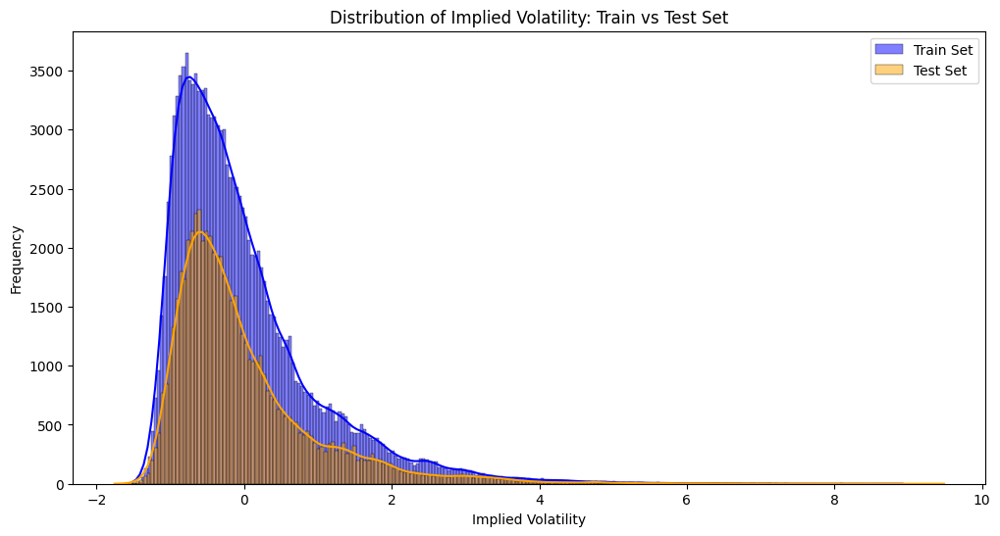

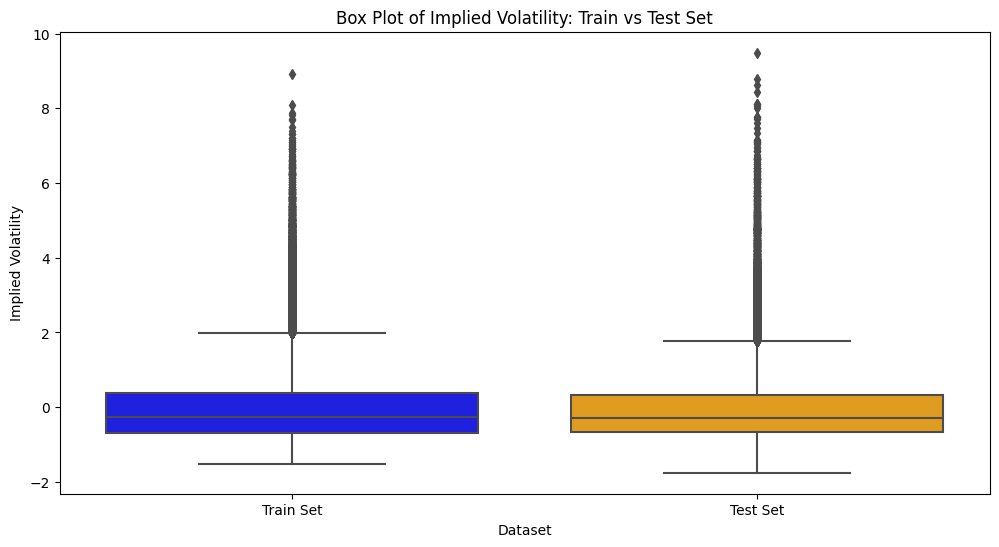

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns

# Split into training and test sets
train_data = standardized_data_s
test_data = standardized_data_test

# Separate target variable
y_train = standardized_data_s['impl_volatility']
y_test = standardized_data_test['impl_volatility']

# Plot histogram of implied volatility for training and test sets
plt.figure(figsize=(12, 6))
sns.histplot(y_train, color='blue', kde=True, label='Train Set')
sns.histplot(y_test, color='orange', kde=True, label='Test Set')
plt.title('Distribution of Implied Volatility: Train vs Test Set')
plt.xlabel('Implied Volatility')
plt.ylabel('Frequency')
plt.legend()
plt.show()

# Plot box plot of implied volatility for training and test sets
plt.figure(figsize=(12, 6))
sns.boxplot(data=[y_train, y_test], palette=['blue', 'orange'])
plt.title('Box Plot of Implied Volatility: Train vs Test Set')
plt.xlabel('Dataset')
plt.ylabel('Implied Volatility')
plt.xticks([0, 1], ['Train Set', 'Test Set'])
plt.show()


In [36]:
#Aplying filter to test the data
standardized_data_test.fillna(0, inplace=True)
standardized_data_s.fillna(0, inplace=True)

final_grouped_df = standardized_data_s

standardized_data_test.to_csv('/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Standardized_data/standardized_features_test_tech.csv', index=False)
final_grouped_df.to_csv('/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Standardized_data/standardized_features_tech.csv', index=False)

data_set_tech = Path.cwd().parent.parent / "Data/Standardized_data/standardized_features_tech.parquet"
data_set_test_tech = Path.cwd().parent.parent / "Data/Standardized_data/standardized_features_test_tech.parquet"

save_parquet = True
if save_parquet or not os.path.exists(data_set_tech):
    final_grouped_df.to_parquet(data_set_tech)

if save_parquet or not os.path.exists(data_set_test_tech):
    standardized_data_test.to_parquet(data_set_test_tech)

# filter_version = final_grouped_df[(final_grouped_df['m_category'] == '|m|≤0.5') & (final_grouped_df['maturity_group'] == 'τ≤5') & (final_grouped_df['Ticker'] == 'AAPL')]
# filter_version = final_grouped_df[(final_grouped_df['m_category'] == '-0.5<m≤0') & (final_grouped_df['maturity_group'] == 'τ≤5')]
# filter_version = final_grouped_df[(final_grouped_df['Ticker'] == 'AMZN')]
filter_version = final_grouped_df

In [37]:
final_grouped_df

,Ticker,cp_flag,date,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,HIGH_vix,...,std_dolvol,std_turn,stdacc,stdcf,tang,tau,tb,trading_day,turn,zerotrade
115045,MSFT,P,2019-03-05,1.716122,1.479884,1.573591,-0.064521,-0.671308,1.220835,-0.668223,...,-1.600725,-1.184828,2.088487,2.750338,0.668953,-0.124661,2.023191,-1.486127,-1.057502,2.223900
67574,AAPL,P,2019-11-26,0.407778,0.541578,0.572684,-0.241997,-0.916252,0.393473,-0.930438,...,-0.604887,-0.856732,-2.056212,-1.312409,-2.501919,-0.852804,2.691157,-0.248449,-0.739037,0.352626
23646,AMZN,C,2019-11-26,0.418652,0.551123,0.583574,0.120706,-0.892902,0.394713,-0.909980,...,0.660153,-0.209230,0.106169,-0.251532,-0.223053,-0.850217,-0.056115,-0.263095,-0.672629,0.255938
117200,MSFT,P,2019-12-18,0.648086,0.546284,0.631471,0.292021,-0.865487,0.393473,-0.883172,...,-0.997021,-1.306038,1.833798,2.799462,0.668953,-0.852804,2.023191,-0.148096,-1.366169,4.038500
52610,MSFT,C,2019-11-27,0.459347,0.576673,0.615299,0.164754,-0.869379,0.394713,-0.915749,...,-0.875950,-1.293656,1.851895,2.881119,0.718776,-1.578559,1.973093,-0.256378,-1.345428,2.508401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111190,META,P,2020-03-19,-0.419950,-0.757785,-0.540662,-2.964331,4.256765,-0.920572,4.549073,...,0.492304,-0.253958,-0.012275,-0.139315,0.122241,-1.580946,-3.323687,0.266693,-0.827668,0.736522
125353,NVDA,P,2020-03-19,-0.419950,-0.757785,-0.540662,-3.784035,4.256765,-0.920572,4.549073,...,3.033908,2.408339,0.748727,0.486038,1.503686,-1.580946,-0.308817,0.266693,0.761989,-0.995299
111189,META,P,2020-03-19,-0.419950,-0.757785,-0.540662,-2.964331,4.256765,-0.920572,4.549073,...,0.492304,-0.253958,-0.012275,-0.139315,0.122241,-1.580946,-3.323687,0.266693,-0.827668,0.736522
125339,NVDA,P,2020-03-18,-0.339847,-0.680595,-0.471385,-3.595171,4.650198,-0.871904,4.788780,...,2.798561,2.265236,0.748727,0.486038,1.503686,-0.852804,-0.308817,0.260003,0.745757,-0.976360


## Selecting training sample

In [38]:
import pandas as pd

filter_version_copy = filter_version.copy()
data = filter_version_copy

def samplesplitting(data, train, validate, oos, window_year):
    # Create empty DataFrames for the splits
    train_data = pd.DataFrame()
    validate_data = pd.DataFrame()
    oos_data = pd.DataFrame()
    pred_data = pd.DataFrame()
    total_train_data = pd.DataFrame()

    # Ensure the 'date' column is of datetime type and set it as index
    data['date'] = pd.to_datetime(data['date'])
    data.set_index('date', inplace=True)

    # Get unique tickers, cp_flags, m_categories, and maturity_groups
    unique_tickers = data['Ticker'].unique()
    unique_cp_flags = data['cp_flag'].unique()
    unique_m_categories = data['m_category'].unique()
    # unique_maturity_groups = data['maturity_group'].unique()

    for ticker in unique_tickers:
        for cp_flag in unique_cp_flags:
            for m_category in unique_m_categories:
                # for maturity_group in unique_maturity_groups:
                    # Filter data for the current group
                group_data = data[
                    (data['Ticker'] == ticker) &
                    (data['cp_flag'] == cp_flag) &
                    (data['m_category'] == m_category)
                    # (data['maturity_group'] == maturity_group)
                ]
                if not group_data.empty:
                    # Define date ranges
                    train_end_year = window_year + train
                    validate_end_year = train_end_year + validate
                    oos_end_year = validate_end_year + oos
                    # Split the group_data ensuring no overlap
                    train_split = group_data[(group_data.index.year >= window_year) & (group_data.index.year < train_end_year)]
                    validate_split = group_data[(group_data.index.year >= train_end_year) & (group_data.index.year < validate_end_year)]
                    oos_split = group_data[(group_data.index.year >= validate_end_year) & (group_data.index.year < oos_end_year)]
                    total_train_split = group_data[(group_data.index.year >= window_year) & (group_data.index.year < validate_end_year)]
                    pred_split = group_data[(group_data.index.year >= validate_end_year) & (group_data.index.year < oos_end_year)]
                    # Append to the corresponding DataFrames
                    train_data = pd.concat([train_data, train_split])
                    validate_data = pd.concat([validate_data, validate_split])
                    oos_data = pd.concat([oos_data, oos_split])
                    total_train_data = pd.concat([total_train_data, total_train_split])
                    pred_data = pd.concat([pred_data, pred_split])

    print('train=%d, validate=%d, oos=%d' % (len(train_data), len(validate_data), len(oos_data)))
    return train_data, validate_data, oos_data, total_train_data, pred_data

print(data)

# Convert 'date' column to datetime format
if not isinstance(data['date'], pd.DatetimeIndex):
    data['date'] = pd.to_datetime(data['date'])

# Example of parameters
trainsize = 1  # Number of years for training data
validatesize = 1  # Number of years for validation data
oossize = 1  # Number of years for out-of-sample data
window_year = 2019  # Window year for prediction

# Call the function to split the data
train, validate, oos, total_train, pred_data = samplesplitting(data, trainsize, validatesize, oossize, window_year)

# # Display the tail of the selected data
# print("Train data:")
# print(train.tail())
# print("\nValidation data:")
# print(validate.tail())
# print("\nOut-of-sample data:")
# print(oos.tail())
# print("\nTotal training data:")
# print(total_train.tail())
# print("\nPrediction data:")
# print(pred_data.tail())


       Ticker cp_flag       date   10Y_RIR   1Y_bond   2Y_bond  \
115045   MSFT       P 2019-03-05  1.716122  1.479884  1.573591   
67574    AAPL       P 2019-11-26  0.407778  0.541578  0.572684   
23646    AMZN       C 2019-11-26  0.418652  0.551123  0.583574   
117200   MSFT       P 2019-12-18  0.648086  0.546284  0.631471   
52610    MSFT       C 2019-11-27  0.459347  0.576673  0.615299   
...       ...     ...        ...       ...       ...       ...   
111190   META       P 2020-03-19 -0.419950 -0.757785 -0.540662   
125353   NVDA       P 2020-03-19 -0.419950 -0.757785 -0.540662   
111189   META       P 2020-03-19 -0.419950 -0.757785 -0.540662   
125339   NVDA       P 2020-03-18 -0.339847 -0.680595 -0.471385   
59897    NVDA       C 2020-03-12 -0.747942 -0.593912 -0.520471   

        5_day_rolling_return_stock  CLOSE_vix   FF_rate  HIGH_vix  ...  \
115045                   -0.064521  -0.671308  1.220835 -0.668223  ...   
67574                    -0.241997  -0.916252  0.393473 -0.

KeyError: 'm_category'

# Save the train and validation data of the stocks

In [ ]:
data_set_train = Path.cwd().parent.parent / "Data/Standardized_data/train_data_tech.parquet"
data_set_validate = Path.cwd().parent.parent / "Data/Standardized_data/validate_data_tech.parquet"
data_set_total_train = Path.cwd().parent.parent / "Data/Standardized_data/total_train_data_tech.parquet"

save_parquet = True
if save_parquet or not os.path.exists(data_set_train):
    train.to_parquet(data_set_train)

if save_parquet or not os.path.exists(data_set_validate):
    validate.to_parquet(data_set_validate)

if save_parquet or not os.path.exists(data_set_total_train):
    total_train.to_parquet(data_set_total_train)


In [ ]:
#We drop the following columns cause they have tomuch influence on the implied volatility
# Columns to be dropped

columns_to_drop = ['prev_day_iv','trading_days_till_exp','moneyness', 'tau', 'lag_trading_days']

if 'moneyness' in train.columns:
    print("Column 'moneyness' exists in train.")
    train = train.drop(columns=columns_to_drop)
    validate = validate.drop(columns=columns_to_drop)
    total_train = total_train.drop(columns=columns_to_drop)

Column 'moneyness' exists in train.


In [ ]:
total_train

,m_category,Ticker,cp_flag,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,HIGH_vix,...,spread_vix,std_dolvol,std_turn,stdacc,stdcf,tang,tb,trading_day,turn,zerotrade
date,,,,,,,,,,,,,,,,,,,,,
2019-01-02,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,0.485951,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,0.485951,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,0.485951,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,0.485951,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,0.485951,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,-0.138076,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,-0.138076,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,-0.138076,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130


In [ ]:
# Column to move to the first position
column_to_move = 'impl_volatility'

# Remove the column and store it
col = total_train.pop(column_to_move)

# Insert the column at the first position
total_train.insert(0, column_to_move, col)

total_train.iloc[:, 1:]

/var/folders/b4/wn87d6495j1_vytb8m33q3mm0000gn/T/ipykernel_33722/3928048585.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  total_train.insert(0, column_to_move, col)


,m_category,Ticker,cp_flag,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,HIGH_vix,...,spread_vix,std_dolvol,std_turn,stdacc,stdcf,tang,tb,trading_day,turn,zerotrade
date,,,,,,,,,,,,,,,,,,,,,
2019-01-02,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,0.485951,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,0.485951,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,0.485951,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,0.485951,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,0.485951,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,-0.138076,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,-0.138076,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,-0.138076,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130


In [ ]:
total_train

,impl_volatility,m_category,Ticker,cp_flag,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,...,spread_vix,std_dolvol,std_turn,stdacc,stdcf,tang,tb,trading_day,turn,zerotrade
date,,,,,,,,,,,,,,,,,,,,,
2019-01-02,0.480728,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.416335,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.401088,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.251588,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.125322,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,-0.451145,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,-0.227564,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,-0.260474,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130


In [ ]:
#Remove features

# columns_to_drop = ['prev_day_iv','trading_days_till_exp','moneyness', 'tau', 'lag_trading_days']
# total_train = total_train.drop(columns=columns_to_drop)

## ElasticNet

In [ ]:
# def feature_selection(IV, data, l1_ratio):
#     """
#     Perform feature selection using ElasticNet regression.
    
#     Parameters:
#     IV (str): The name of the independent variable to predict.
#     data (pd.DataFrame): The dataset containing the features and the independent variable.
#     l1_ratio (float): The mixing parameter between L1 and L2 regularization.
    
#     Returns:
#     np.ndarray: The selected features.
#     """
#     # Separate the independent variable and the features
#     data_y = data[IV]
#     features = data.iloc[:, 5:]
#     # data.set_index(['date'], inplace=True)

#     # Initialize and fit the ElasticNet model
#     enet_model = ElasticNet(alpha=0.5, l1_ratio=l1_ratio)
#     enet_model.fit(features, data_y)

#     # Get the coefficients from the model
#     coef = enet_model.coef_

#     # Identify features with zero coefficients
#     zero_features = np.where(coef == 0)[0]
#     print("Number of features set to zero for", IV, "are:", zero_features.shape[0])
#     print(features.shape[1] - zero_features.shape[0], "features remaining.")

#     # Select features with non-zero coefficients
#     mask = coef != 0
#     selected_features = features.columns[mask]
#     print(selected_features)

#     # Create a DataFrame for the feature importances
#     features_elnet = pd.DataFrame(data=np.absolute(coef[mask]), columns=["Importance"])
#     features_elnet.index = selected_features

#     # Sort the features by importance
#     sorted_features_elnet = features_elnet.sort_values(by="Importance", ascending=False)

#     # Plot the feature importances
#     colors = cm.viridis(np.linspace(0, 1, 7))
#     font_name = 'Liberation Serif'
#     plt.figure(figsize=(15, 5))
#     plt.bar(sorted_features_elnet.index, sorted_features_elnet["Importance"], color=colors[2])
#     plt.ylabel("Weight", fontsize=15, fontname=font_name)
#     plt.xticks(rotation=60, fontname=font_name, fontsize=12)
#     plt.yticks(fontname=font_name, fontsize=12)
#     plt.margins(x=0.01)
#     plt.show()

#     return selected_features.to_numpy()
#     # return data.columns


# selected_features = feature_selection('impl_volatility', total_train, 0.14)
# # Example usage
# # IV = 'dependent_variable_column_name'
# # data = pd.read_csv('path_to_your_data.csv')
# # l1_ratio = 0.5
# # selected_features = feature_selection(IV, data, l1_ratio)
# print(selected_features)


In [ ]:
# import numpy as np
# import pandas as pd
# from sklearn.linear_model import ElasticNetCV
# import matplotlib.pyplot as plt
# import matplotlib.cm as cm
# import logging

# # Suppress font warnings
# logging.getLogger('matplotlib.font_manager').setLevel(logging.ERROR)

# def feature_selection(IV, data, ticker, cp_flag, m_category, maturity_group):
#     """
#     Perform feature selection using ElasticNet regression for a specific group.

#     Parameters:
#     IV (str): The name of the independent variable to predict.
#     data (pd.DataFrame): The dataset containing the features and the independent variable.
#     ticker (str): The ticker for the group.
#     cp_flag (str): The cp_flag for the group.
#     m_category (str): The m_category for the group.
#     maturity_group (str): The maturity_group for the group.

#     Returns:
#     np.ndarray: The selected features.
#     """
#     # Separate the independent variable and the features
#     data_y = data[IV]
#     features = data.iloc[:, 5:]

#     # Define the range for alpha and l1_ratio
#     alphas = np.logspace(-10, 0, 100)
#     l1_ratios = np.linspace(0, 1, 10)

#     # Initialize and fit the ElasticNetCV model
#     enet_cv_model = ElasticNetCV(alphas=alphas, l1_ratio=l1_ratios, cv=5)
#     enet_cv_model.fit(features, data_y)

#     # Get the best parameters
#     best_alpha = enet_cv_model.alpha_
#     best_l1_ratio = enet_cv_model.l1_ratio_

#     # Get the coefficients from the model
#     coef = enet_cv_model.coef_

#     # Identify features with zero coefficients
#     zero_features = np.where(coef == 0)[0]

#     # Select features with non-zero coefficients
#     mask = coef != 0
#     selected_features = features.columns[mask]
#     print(selected_features)

#     # Create a DataFrame for the feature importances
#     features_elnet = pd.DataFrame(data=np.absolute(coef[mask]), columns=["Importance"])
#     features_elnet.index = selected_features

#     # Sort the features by importance
#     sorted_features_elnet = features_elnet.sort_values(by="Importance", ascending=False)

#     # Select top 20 features if more than 20 are selected
#     if sorted_features_elnet.shape[0] > 20:
#         sorted_features_elnet = sorted_features_elnet.head(20)

#     # Plot the feature importances
#     colors = cm.viridis(np.linspace(0, 1, 7))
#     font_name = 'Liberation Serif'
#     plt.figure(figsize=(15, 5))
#     plt.bar(sorted_features_elnet.index, sorted_features_elnet["Importance"], color=colors[2])
#     plt.ylabel("Weight", fontsize=15, fontname=font_name)
#     plt.xticks(rotation=60, fontname=font_name, fontsize=12)
#     plt.yticks(fontname=font_name, fontsize=12)
#     plt.margins(x=0.01)
#     plt.title(f"Feature Selection for Group: {ticker}, {cp_flag}, {m_category}, {maturity_group}")
#     plt.show()

#     return selected_features.to_numpy(), coef, best_alpha, best_l1_ratio

# # Define the file path for the CSV file
# csv_file_path = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features1.csv'

# # Create a new file or overwrite an existing one
# with open(csv_file_path, 'w') as f:
#     f.write('Ticker,cp_flag,m_category,maturity_group,alpha,l1_ratio,' + ','.join(total_train.columns[5:]) + '\n')

# # Get unique tickers, cp_flags, m_categories, and maturity_groups
# unique_tickers = total_train['Ticker'].unique()
# unique_cp_flags = total_train['cp_flag'].unique()
# unique_m_categories = total_train['m_category'].unique()
# unique_maturity_groups = total_train['maturity_group'].unique()

# # Loop through each group and perform feature selection
# for ticker in unique_tickers:
#     for cp_flag in unique_cp_flags:
#         for m_category in unique_m_categories:
#             for maturity_group in unique_maturity_groups:
#                 # Filter data for the current group
#                 group_data = total_train[
#                     (total_train['Ticker'] == ticker) &
#                     (total_train['cp_flag'] == cp_flag) &
#                     (total_train['m_category'] == m_category) &
#                     (total_train['maturity_group'] == maturity_group)
#                 ]

#                 if not group_data.empty:
#                     selected_features, coeff, best_alpha, best_l1_ratio = feature_selection('impl_volatility', group_data, ticker, cp_flag, m_category, maturity_group)
#                     print(f"Selected features for group {ticker}, {cp_flag}, {m_category}, {maturity_group}: {selected_features}")
#                     print(f"Best alpha: {best_alpha}, Best l1_ratio: {best_l1_ratio}")

#                     # Append the selected features and their importances to the CSV file
#                     with open(csv_file_path, 'a') as f:
#                         f.write(f'{ticker},{cp_flag},{m_category},{maturity_group},{best_alpha},{best_l1_ratio},' + ','.join(map(str, coeff)) + '\n')


# Just for the tech data and put/call type

In [ ]:
# import numpy as np
# import pandas as pd
# from sklearn.linear_model import ElasticNetCV
# from sklearn.preprocessing import StandardScaler
# import matplotlib.pyplot as plt
# import matplotlib.cm as cm
# import logging

# # Suppress font warnings
# logging.getLogger('matplotlib.font_manager').setLevel(logging.ERROR)

# def feature_selection(IV, combined_data, cp_flag):
#     """
#     Perform feature selection using ElasticNet regression for a specific cp_flag group.

#     Parameters:
#     IV (str): The name of the independent variable to predict.
#     combined_data (pd.DataFrame): The combined dataset containing the features and the independent variable.
#     cp_flag (str): The cp_flag for the group.

#     Returns:
#     pd.DataFrame: Sorted feature importances.
#     """
#     # Separate the independent variable and the features
#     data_y = combined_data[IV]
#     features = combined_data.iloc[:, 4:]

#     # Standardize the features
#     # scaler = StandardScaler()
#     # features_scaled = scaler.fit_transform(features)

#     # Define the range for alpha and l1_ratio
#     alphas = np.logspace(-10, 0, 100)
#     l1_ratios = np.linspace(0, 1, 10)

#     # Initialize and fit the ElasticNetCV model
#     enet_cv_model = ElasticNetCV(alphas=alphas, l1_ratio=l1_ratios, cv=5)
#     enet_cv_model.fit(features, data_y)

#     # Get the best parameters
#     best_alpha = enet_cv_model.alpha_
#     best_l1_ratio = enet_cv_model.l1_ratio_

#     # Get the coefficients from the model
#     coef = enet_cv_model.coef_

#     # Identify features with zero coefficients
#     zero_features = np.where(coef == 0)[0]

#     # Select features with non-zero coefficients
#     mask = coef != 0
#     selected_features = features.columns[mask]
#     print(selected_features)

#     # Create a DataFrame for the feature importances
#     features_elnet = pd.DataFrame(data=np.absolute(coef[mask]), columns=["Importance"])
#     features_elnet.index = selected_features

#     # Sort the features by importance
#     sorted_features_elnet = features_elnet.sort_values(by="Importance", ascending=False)

#     # Select top 20 features if more than 20 are selected
#     if sorted_features_elnet.shape[0] > 20:
#         sorted_features_elnet = sorted_features_elnet.head(20)

#     return sorted_features_elnet

# # Combine data from all stocks for each cp_flag
# def aggregate_data(total_train, cp_flag):
#     combined_data = pd.DataFrame()
#     unique_tickers = total_train['Ticker'].unique()
#     unique_m_categories = total_train['m_category'].unique()
#     # unique_maturity_groups = total_train['maturity_group'].unique()

#     for ticker in unique_tickers:
#         for m_category in unique_m_categories:
#             # for maturity_group in unique_maturity_groups:
#             group_data = total_train[
#                 (total_train['Ticker'] == ticker) &
#                 (total_train['cp_flag'] == cp_flag) &
#                 (total_train['m_category'] == m_category) 
#                 # (total_train['maturity_group'] == maturity_group)
#             ]
#             if not group_data.empty:
#                 combined_data = pd.concat([combined_data, group_data])
#     return combined_data

# # Define the file paths for the CSV files
# csv_file_path_call = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv'
# csv_file_path_put = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv'

# # Aggregate data for calls and puts
# combined_data_call = aggregate_data(total_train, 'C')
# combined_data_put = aggregate_data(total_train, 'P')

# # Perform feature selection for calls
# sorted_features_elnet_call = feature_selection('impl_volatility', combined_data_call, 'C')
# # Perform feature selection for puts
# sorted_features_elnet_put = feature_selection('impl_volatility', combined_data_put, 'P')

# # Plot the feature importances for calls
# colors = cm.viridis(np.linspace(0, 1, 7))
# font_name = 'Liberation Serif'
# plt.figure(figsize=(15, 5))
# plt.bar(sorted_features_elnet_call.index, sorted_features_elnet_call["Importance"], color=colors[2])
# plt.ylabel("Weight", fontsize=15, fontname=font_name)
# plt.xticks(rotation=60, fontname=font_name, fontsize=12)
# plt.yticks(fontname=font_name, fontsize=12)
# plt.margins(x=0.01)
# plt.title("Feature Selection for Call Options")
# plt.show()

# # Plot the feature importances for puts
# plt.figure(figsize=(15, 5))
# plt.bar(sorted_features_elnet_put.index, sorted_features_elnet_put["Importance"], color=colors[2])
# plt.ylabel("Weight", fontsize=15, fontname=font_name)
# plt.xticks(rotation=60, fontname=font_name, fontsize=12)
# plt.yticks(fontname=font_name, fontsize=12)
# plt.margins(x=0.01)
# plt.title("Feature Selection for Put Options")
# plt.show()

# # Save the sorted features to CSV files
# sorted_features_elnet_call.to_csv(csv_file_path_call)
# sorted_features_elnet_put.to_csv(csv_file_path_put)


In [ ]:
# import numpy as np
# import pandas as pd
# from sklearn.linear_model import ElasticNetCV
# from sklearn.preprocessing import StandardScaler
# import matplotlib.pyplot as plt
# import matplotlib.cm as cm
# from sklearn.metrics import mean_squared_error, r2_score
# import logging

# # Suppress font warnings
# logging.getLogger('matplotlib.font_manager').setLevel(logging.ERROR)

# def feature_selection(IV, combined_data, cp_flag):
#     """
#     Perform feature selection using ElasticNet regression for a specific cp_flag group.

#     Parameters:
#     IV (str): The name of the independent variable to predict.
#     combined_data (pd.DataFrame): The combined dataset containing the features and the independent variable.
#     cp_flag (str): The cp_flag for the group.

#     Returns:
#     pd.DataFrame: Sorted feature importances.
#     """
#     # Separate the independent variable and the features
#     data_y = combined_data[IV]
#     features = combined_data.iloc[:, 4:]

#     # Ensure only numeric columns are used
#     features = features.select_dtypes(include=[np.number])

#     # Standardize the features
#     scaler = StandardScaler()
#     features_scaled = scaler.fit_transform(features)

#     # Define the range for alpha and l1_ratio
#     alphas = np.logspace(-10, 0, 100)
#     l1_ratios = np.linspace(0, 1, 10)

#     # Initialize and fit the ElasticNetCV model
#     enet_cv_model = ElasticNetCV(alphas=alphas, l1_ratio=l1_ratios, cv=5)
#     enet_cv_model.fit(features_scaled, data_y)

#     # Get the best parameters
#     best_alpha = enet_cv_model.alpha_
#     best_l1_ratio = enet_cv_model.l1_ratio_

#     # Get the coefficients from the model
#     coef = enet_cv_model.coef_

#     # Identify features with zero coefficients
#     zero_features = np.where(coef == 0)[0]

#     # Select features with non-zero coefficients
#     mask = coef != 0
#     selected_features = features.columns[mask]
#     print(selected_features)

#     # Create a DataFrame for the feature importances
#     features_elnet = pd.DataFrame(data=np.absolute(coef[mask]), columns=["Importance"])
#     features_elnet.index = selected_features

#     # Sort the features by importance
#     sorted_features_elnet = features_elnet.sort_values(by="Importance", ascending=False)

#     # Select top 20 features if more than 20 are selected
#     if sorted_features_elnet.shape[0] > 20:
#         sorted_features_elnet = sorted_features_elnet.head(20)

#     return sorted_features_elnet, best_alpha, best_l1_ratio, enet_cv_model

# # Combine data from all stocks for each cp_flag
# def aggregate_data(total_train, cp_flag):
#     combined_data = pd.DataFrame()
#     unique_tickers = total_train['Ticker'].unique()
#     unique_m_categories = total_train['m_category'].unique()

#     for ticker in unique_tickers:
#         for m_category in unique_m_categories:
#             group_data = total_train[
#                 (total_train['Ticker'] == ticker) &
#                 (total_train['cp_flag'] == cp_flag) &
#                 (total_train['m_category'] == m_category)
#             ]
#             if not group_data.empty:
#                 combined_data = pd.concat([combined_data, group_data])
#     return combined_data

# # Define the file paths for the CSV files
# csv_file_path_call = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv'
# csv_file_path_put = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv'

# # Aggregate data for calls and puts
# combined_data_call = aggregate_data(total_train, 'C')
# combined_data_put = aggregate_data(total_train, 'P')

# # Perform feature selection for calls
# sorted_features_elnet_call, best_alpha_call, best_l1_ratio_call, model_call = feature_selection('impl_volatility', combined_data_call, 'C')
# # Perform feature selection for puts
# sorted_features_elnet_put, best_alpha_put, best_l1_ratio_put, model_put = feature_selection('impl_volatility', combined_data_put, 'P')

# # Predict and evaluate model performance for calls
# scaler_call = StandardScaler()
# features_call_scaled = scaler_call.fit_transform(combined_data_call.iloc[:, 4:].select_dtypes(include=[np.number]))
# predictions_call = model_call.predict(features_call_scaled)
# rmse_call = np.sqrt(mean_squared_error(combined_data_call['impl_volatility'], predictions_call))
# r2_call = r2_score(combined_data_call['impl_volatility'], predictions_call)
# print(f"Calls - RMSE: {rmse_call}, R^2: {r2_call}")

# # Predict and evaluate model performance for puts
# scaler_put = StandardScaler()
# features_put_scaled = scaler_put.fit_transform(combined_data_put.iloc[:, 4:].select_dtypes(include=[np.number]))
# predictions_put = model_put.predict(features_put_scaled)
# rmse_put = np.sqrt(mean_squared_error(combined_data_put['impl_volatility'], predictions_put))
# r2_put = r2_score(combined_data_put['impl_volatility'], predictions_put)
# print(f"Puts - RMSE: {rmse_put}, R^2: {r2_put}")

# # Plot the feature importances for calls
# colors = cm.viridis(np.linspace(0, 1, 7))
# font_name = 'Liberation Serif'
# plt.figure(figsize=(15, 5))
# plt.bar(sorted_features_elnet_call.index, sorted_features_elnet_call["Importance"], color=colors[2])
# plt.ylabel("Weight", fontsize=15, fontname=font_name)
# plt.xticks(rotation=60, fontname=font_name, fontsize=12)
# plt.yticks(fontname=font_name, fontsize=12)
# plt.margins(x=0.01)
# plt.title(f"Feature Selection for Call Options (Alpha: {best_alpha_call:.2e}, L1 Ratio: {best_l1_ratio_call:.2f})")
# plt.show()

# # Plot the feature importances for puts
# plt.figure(figsize=(15, 5))
# plt.bar(sorted_features_elnet_put.index, sorted_features_elnet_put["Importance"], color=colors[2])
# plt.ylabel("Weight", fontsize=15, fontname=font_name)
# plt.xticks(rotation=60, fontname=font_name, fontsize=12)
# plt.yticks(fontname=font_name, fontsize=12)
# plt.margins(x=0.01)
# plt.title(f"Feature Selection for Put Options (Alpha: {best_alpha_put:.2e}, L1 Ratio: {best_l1_ratio_put:.2f})")
# plt.show()

# # Save the sorted features to CSV files
# sorted_features_elnet_call.to_csv(csv_file_path_call)
# sorted_features_elnet_put.to_csv(csv_file_path_put)


In [ ]:
total_train

,impl_volatility,m_category,Ticker,cp_flag,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,...,spread_vix,std_dolvol,std_turn,stdacc,stdcf,tang,tb,trading_day,turn,zerotrade
date,,,,,,,,,,,,,,,,,,,,,
2019-01-02,0.480728,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.416335,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.401088,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.251588,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.125322,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,-0.451145,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,-0.227564,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,-0.260474,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130


In [ ]:
total_trains = total_train.copy()
filter_version = total_trains[(total_trains['Ticker'] == 'TSLA') | (total_trains['Ticker'] == 'AMZN') | (total_trains['Ticker'] == 'AAPL') & (total_trains['m_category'] == '|m|≤0.5')]
filter_version

,impl_volatility,m_category,Ticker,cp_flag,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,...,spread_vix,std_dolvol,std_turn,stdacc,stdcf,tang,tb,trading_day,turn,zerotrade
date,,,,,,,,,,,,,,,,,,,,,
2019-01-02,0.482890,|m|≤0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.124237,|m|≤0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,-0.197763,|m|≤0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,-0.431819,|m|≤0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,-0.563704,|m|≤0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,-0.451145,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,-0.227564,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,-0.260474,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130


In [ ]:
total_train

,impl_volatility,m_category,Ticker,cp_flag,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,...,spread_vix,std_dolvol,std_turn,stdacc,stdcf,tang,tb,trading_day,turn,zerotrade
date,,,,,,,,,,,,,,,,,,,,,
2019-01-02,0.480728,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.416335,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.401088,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.251588,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.125322,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,-0.451145,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,-0.227564,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,-0.260474,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130


In [ ]:
import numpy as np
import pandas as pd
from sklearn.linear_model import ElasticNetCV
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import logging

filter_version

# Suppress font warnings
logging.getLogger('matplotlib.font_manager').setLevel(logging.ERROR)

def feature_selection(IV, combined_data, cp_flag):
    """
    Perform feature selection using ElasticNet regression for a specific cp_flag group.

    Parameters:
    IV (str): The name of the independent variable to predict.
    combined_data (pd.DataFrame): The combined dataset containing the features and the independent variable.
    cp_flag (str): The cp_flag for the group.

    Returns:
    pd.DataFrame: Sorted feature importances.
    """
    # Separate the independent variable and the features
    data_y = combined_data[IV]
    features = combined_data.iloc[:, 4:]

    # Standardize the features
    # scaler = StandardScaler()
    # features_scaled = scaler.fit_transform(features)

    # Define the range for alpha and l1_ratio
    alphas = np.logspace(-10, 0, 100)
    l1_ratios = np.linspace(0, 1, 10)

    # Initialize and fit the ElasticNetCV model
    enet_cv_model = ElasticNetCV(alphas=alphas, l1_ratio=l1_ratios, cv=5)
    enet_cv_model.fit(features, data_y)

    # Get the best parameters
    best_alpha = enet_cv_model.alpha_
    best_l1_ratio = enet_cv_model.l1_ratio_

    # Get the coefficients from the model
    coef = enet_cv_model.coef_

    # Identify features with zero coefficients
    zero_features = np.where(coef == 0)[0]

    # Select features with non-zero coefficients
    mask = coef != 0
    selected_features = features.columns[mask]
    print(selected_features)

    # Create a DataFrame for the feature importances
    features_elnet = pd.DataFrame(data=np.absolute(coef[mask]), columns=["Importance"])
    features_elnet.index = selected_features

    # Sort the features by importance
    sorted_features_elnet = features_elnet.sort_values(by="Importance", ascending=False)

    # Select top 20 features if more than 20 are selected
    if sorted_features_elnet.shape[0] > 20:
        sorted_features_elnet = sorted_features_elnet.head(20)

    return sorted_features_elnet, best_alpha, best_l1_ratio

# Combine data from all stocks for each cp_flag
def aggregate_data(filter_version, cp_flag):
    combined_data = pd.DataFrame()
    unique_tickers = filter_version['Ticker'].unique()
    unique_m_categories = filter_version['m_category'].unique()
    # unique_maturity_groups = total_train['maturity_group'].unique()

    for ticker in unique_tickers:
        for m_category in unique_m_categories:
            # for maturity_group in unique_maturity_groups:
            group_data = filter_version[
                (filter_version['Ticker'] == ticker) &
                (filter_version['cp_flag'] == cp_flag) &
                (filter_version['m_category'] == m_category) 
                # (total_train['maturity_group'] == maturity_group)
            ]
            if not group_data.empty:
                combined_data = pd.concat([combined_data, group_data])
    return combined_data

# Define the file paths for the CSV files
csv_file_path_call = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv'
csv_file_path_put = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv'

# Aggregate data for calls and puts
combined_data_call = aggregate_data(filter_version, 'C')
combined_data_put = aggregate_data(filter_version, 'P')

# Perform feature selection for calls
sorted_features_elnet_call, best_alpha_call, best_l1_ratio_call = feature_selection('impl_volatility', combined_data_call, 'C')
# Perform feature selection for puts
sorted_features_elnet_put, best_alpha_put, best_l1_ratio_put = feature_selection('impl_volatility', combined_data_put, 'P')

# Plot the feature importances for calls
colors = cm.viridis(np.linspace(0, 1, 7))
font_name = 'Liberation Serif'
plt.figure(figsize=(15, 5))
plt.bar(sorted_features_elnet_call.index, sorted_features_elnet_call["Importance"], color=colors[2])
plt.ylabel("Weight", fontsize=15, fontname=font_name)
plt.xticks(rotation=60, fontname=font_name, fontsize=12)
plt.yticks(fontname=font_name, fontsize=12)
plt.margins(x=0.01)
plt.title(f"Feature Selection for Call Options (Alpha: {best_alpha_call:.2e}, L1 Ratio: {best_l1_ratio_call:.2f})")
plt.show()

# Plot the feature importances for puts
plt.figure(figsize=(15, 5))
plt.bar(sorted_features_elnet_put.index, sorted_features_elnet_put["Importance"], color=colors[2])
plt.ylabel("Weight", fontsize=15, fontname=font_name)
plt.xticks(rotation=60, fontname=font_name, fontsize=12)
plt.yticks(fontname=font_name, fontsize=12)
plt.margins(x=0.01)
plt.title(f"Feature Selection for Put Options (Alpha: {best_alpha_put:.2e}, L1 Ratio: {best_l1_ratio_put:.2f})")
plt.show()

# Save the sorted features to CSV files
sorted_features_elnet_call.to_csv(csv_file_path_call)
sorted_features_elnet_put.to_csv(csv_file_path_put)


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:614: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:614: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35252.863741261885, tolerance: 10.876362936425929
  model = cd_fast.enet_coordinate_descent_gram(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:614: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/

In [ ]:
total_train

,impl_volatility,m_category,Ticker,cp_flag,10Y_RIR,1Y_bond,2Y_bond,5_day_rolling_return_stock,CLOSE_vix,FF_rate,...,spread_vix,std_dolvol,std_turn,stdacc,stdcf,tang,tb,trading_day,turn,zerotrade
date,,,,,,,,,,,,,,,,,,,,,
2019-01-02,0.480728,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.416335,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.401088,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.251588,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
2019-01-02,0.125322,m<-0.5,AAPL,C,1.625266,1.425181,1.523467,0.773085,0.064354,1.180688,...,1.143898,1.154848,0.987622,-1.180538,-0.657004,-1.098151,-0.926220,-1.781796,0.526520,-0.963962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,-0.451145,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,-0.227564,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130
2020-12-31,-0.260474,|m|≤0.5,TSLA,P,-0.802211,-1.209192,-1.203660,-0.041225,-0.033556,-1.154942,...,-0.557825,1.713135,-0.671459,1.638325,1.213951,1.819784,-1.695609,1.712529,-0.114591,1.421130


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:614: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:614: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 88013.37246449324, tolerance: 28.702706599028794
  model = cd_fast.enet_coordinate_descent_gram(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:614: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/L

Index(['1Y_bond', '2Y_bond', '5_day_rolling_return_stock', 'CLOSE_vix',
       'FF_rate', 'HIGH_vix', 'LOW_vix', 'OPEN_vix', 'PRC', 'PRC_actual',
       ...
       'spread_vix', 'std_dolvol', 'std_turn', 'stdacc', 'stdcf', 'tang', 'tb',
       'trading_day', 'turn', 'zerotrade'],
      dtype='object', length=105)


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:614: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:614: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 88937.94429048238, tolerance: 27.737388829980432
  model = cd_fast.enet_coordinate_descent_gram(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:614: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/L

Index(['1Y_bond', '2Y_bond', '5_day_rolling_return_stock', 'CLOSE_vix',
       'FF_rate', 'HIGH_vix', 'LOW_vix', 'OPEN_vix', 'PRC', 'PRC_actual',
       ...
       'spread_vix', 'std_dolvol', 'std_turn', 'stdacc', 'stdcf', 'tang', 'tb',
       'trading_day', 'turn', 'zerotrade'],
      dtype='object', length=105)
Best alpha for calls: 0.001873817422860383, Best l1_ratio for calls: 0.0
Best alpha for puts: 1e-10, Best l1_ratio for puts: 0.26262626262626265


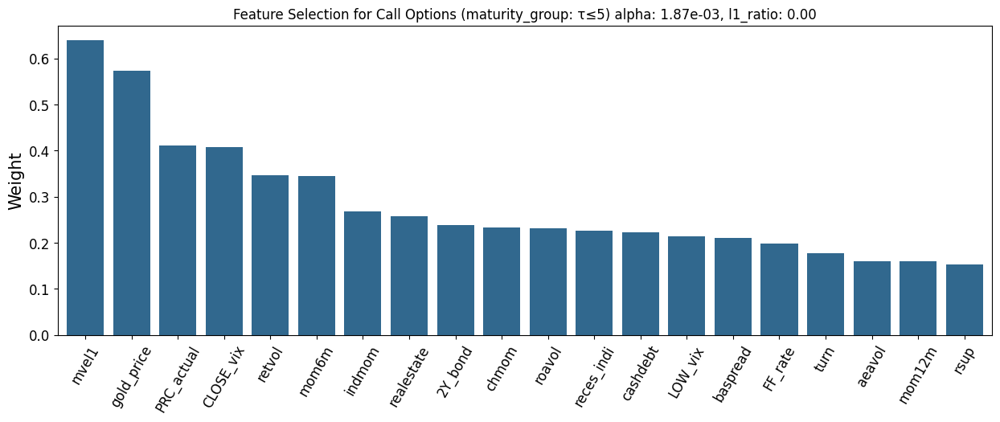

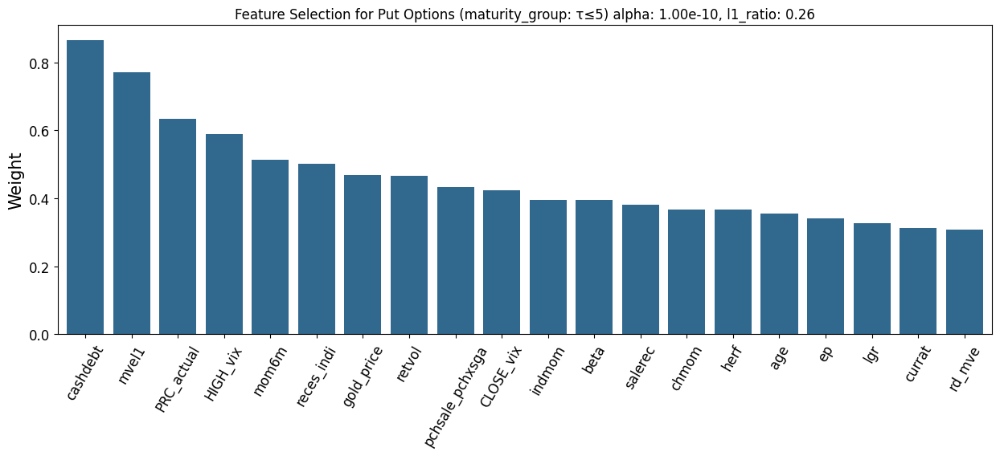

In [ ]:
import numpy as np
import pandas as pd
from sklearn.linear_model import ElasticNetCV
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import logging

# Suppress font warnings
logging.getLogger('matplotlib.font_manager').setLevel(logging.ERROR)

def feature_selection(IV, combined_data, cp_flag):
    """
    Perform feature selection using ElasticNet regression for a specific cp_flag group.

    Parameters:
    IV (str): The name of the independent variable to predict.
    combined_data (pd.DataFrame): The combined dataset containing the features and the independent variable.
    cp_flag (str): The cp_flag for the group.

    Returns:
    pd.DataFrame: Sorted feature importances.
    float: The best alpha value found.
    float: The best l1_ratio value found.
    """
    # Filter for maturity_group with tau <= 5
    # combined_data = combined_data[combined_data['maturity_group'] == "τ≤5"]

    # Separate the independent variable and the features
    data_y = combined_data[IV]
    features = combined_data.iloc[:, 4:]

    # Standardize the features
    scaler = StandardScaler()
    features_scaled = scaler.fit_transform(features)

    # Define the range for alpha and l1_ratio
    alphas = np.logspace(-10, 0, 100)
    l1_ratios = np.linspace(0, 1, 100)

    # Initialize and fit the ElasticNetCV model
    enet_cv_model = ElasticNetCV(alphas=alphas, l1_ratio=l1_ratios, cv=5)
    enet_cv_model.fit(features_scaled, data_y)

    # Get the best parameters
    best_alpha = enet_cv_model.alpha_
    best_l1_ratio = enet_cv_model.l1_ratio_

    # Get the coefficients from the model
    coef = enet_cv_model.coef_

    # Select features with non-zero coefficients
    mask = coef != 0
    selected_features = features.columns[mask]
    print(selected_features)

    # Create a DataFrame for the feature importances
    features_elnet = pd.DataFrame(data=np.absolute(coef[mask]), columns=["Importance"])
    features_elnet.index = selected_features

    # Sort the features by importance
    sorted_features_elnet = features_elnet.sort_values(by="Importance", ascending=False)

    # Select top 20 features if more than 20 are selected
    if sorted_features_elnet.shape[0] > 20:
        sorted_features_elnet = sorted_features_elnet.head(20)

    return sorted_features_elnet, best_alpha, best_l1_ratio

# Combine data from all stocks for each cp_flag
def aggregate_data(total_train, cp_flag):
    combined_data = pd.DataFrame()
    unique_tickers = total_train['Ticker'].unique()
    unique_m_categories = total_train['m_category'].unique()

    for ticker in unique_tickers:
        for m_category in unique_m_categories:
            group_data = total_train[
                (total_train['Ticker'] == ticker) &
                (total_train['cp_flag'] == cp_flag) &
                (total_train['m_category'] == m_category)
                # (total_train['maturity_group']  == "τ≤5")
            ]
            if not group_data.empty:
                combined_data = pd.concat([combined_data, group_data])
                with open(csv_file_path, 'a') as f:
                    f.write(f'{ticker},{cp_flag},{m_category},{best_alpha},{best_l1_ratio},' + ','.join(map(str, coeff)) + '\n')
    return combined_data

# Define the file paths for the CSV files
csv_file_path_call = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv'
csv_file_path_put = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv'

csv_file_path = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_tech_all.csv'

# Create a new file or overwrite an existing one
with open(csv_file_path, 'w') as f:
    f.write('Ticker,cp_flag,m_category,alpha,l1_ratio,' + ','.join(total_train.columns[4:]) + '\n')

# Aggregate data for calls and puts
combined_data_call = aggregate_data(total_train, 'C')
combined_data_put = aggregate_data(total_train, 'P')

# Perform feature selection for calls
sorted_features_elnet_call, best_alpha_call, best_l1_ratio_call = feature_selection('impl_volatility', combined_data_call, 'C')
# Perform feature selection for puts
sorted_features_elnet_put, best_alpha_put, best_l1_ratio_put = feature_selection('impl_volatility', combined_data_put, 'P')

# Print best alpha and l1_ratio for calls
print(f"Best alpha for calls: {best_alpha_call}, Best l1_ratio for calls: {best_l1_ratio_call}")
# Print best alpha and l1_ratio for puts
print(f"Best alpha for puts: {best_alpha_put}, Best l1_ratio for puts: {best_l1_ratio_put}")

# Plot the feature importances for calls
colors = cm.viridis(np.linspace(0, 1, 7))
font_name = 'Liberation Serif'
plt.figure(figsize=(15, 5))
plt.bar(sorted_features_elnet_call.index, sorted_features_elnet_call["Importance"], color=colors[2])
plt.ylabel("Weight", fontsize=15, fontname=font_name)
plt.xticks(rotation=60, fontname=font_name, fontsize=12)
plt.yticks(fontname=font_name, fontsize=12)
plt.margins(x=0.01)
plt.title(f"Feature Selection for Call Options (maturity_group: τ≤5) alpha: {best_alpha_call:.2e}, l1_ratio: {best_l1_ratio_call:.2f}")
plt.show()

# Plot the feature importances for puts
plt.figure(figsize=(15, 5))
plt.bar(sorted_features_elnet_put.index, sorted_features_elnet_put["Importance"], color=colors[2])
plt.ylabel("Weight", fontsize=15, fontname=font_name)
plt.xticks(rotation=60, fontname=font_name, fontsize=12)
plt.yticks(fontname=font_name, fontsize=12)
plt.margins(x=0.01)
plt.title(f"Feature Selection for Put Options (maturity_group: τ≤5) alpha: {best_alpha_put:.2e}, l1_ratio: {best_l1_ratio_put:.2f}")
plt.show()

# Save the sorted features to CSV files
sorted_features_elnet_call.to_csv(csv_file_path_call)
sorted_features_elnet_put.to_csv(csv_file_path_put)


# Calculate the RMSE eand the R^2 on the test data

In [ ]:
import numpy as np
import pandas as pd
from sklearn.linear_model import ElasticNet
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler

def calculate_rmse_r2(train_data, test_data, selected_features, best_alpha, best_l1_ratio):
    """
    Train the model on training data and calculate RMSE and R^2 on test data.

    Parameters:
    train_data (pd.DataFrame): The training dataset.
    test_data (pd.DataFrame): The testing dataset.
    selected_features (list): List of selected features.
    best_alpha (float): The best alpha value found.
    best_l1_ratio (float): The best l1_ratio value found.

    Returns:
    float: RMSE value.
    float: R^2 value.
    """
    # Separate the independent variable and the selected features for training
    X_train_scaled = train_data[selected_features]
    y_train = train_data['impl_volatility']
    
    # # Standardize the features
    # scaler = StandardScaler()
    # X_train_scaled = scaler.fit_transform(X_train)
    
    # # Train the ElasticNet model with the best parameters
    model = ElasticNet(alpha=best_alpha, l1_ratio=best_l1_ratio)
    model.fit(X_train_scaled, y_train)
    
    # Separate the independent variable and the selected features for testing
    X_test_scaled = test_data[selected_features]
    y_test = test_data['impl_volatility']
    # X_test_scaled = scaler.transform(X_test)
    
    # Make predictions on the test set
    y_pred = model.predict(X_test_scaled)
    
    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    
    # Calculate R^2
    r2 = r2_score(y_test, y_pred)
    
    return rmse, r2

# Example usage assuming 'total_train' is your DataFrame and you have performed feature selection
# Define the file paths for the CSV files
csv_file_path_call = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv'
csv_file_path_put = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv'

# Read the CSV files into DataFrames
df_call = pd.read_csv(csv_file_path_call)
df_put = pd.read_csv(csv_file_path_put)

# Extract the features into separate lists
selected_features_call = df_call.iloc[:, 0].tolist()
selected_features_put = df_put.iloc[:, 0].tolist()

best_alpha_call = 1.87*10**-3  # Best alpha for calls
best_l1_ratio_call = 0.89  # Best l1_ratio for calls
best_alpha_put = 1*10**-10  # Best alpha for puts
best_l1_ratio_put = 0.89  # Best l1_ratio for puts

selected_features = [selected_features_call, selected_features_put]
best_alpha = [best_alpha_call, best_alpha_put]  # or best_alpha_put
best_l1_ratio = [best_l1_ratio_call, best_l1_ratio_put] 


# Split your data into training and testing sets
# Here I assume you have a 'date' column to perform a time-based split
train_data = total_train  # Example split
test_data = standardized_data_test  # Example split

train_data_call = train_data[train_data['cp_flag'] == 'C']
test_data_call = test_data[test_data['cp_flag'] == 'C']

train_data_put = train_data[train_data['cp_flag'] == 'P']
test_data_put = test_data[test_data['cp_flag'] == 'P']

# Calculate RMSE and R^2 for the selected features
# rmse, r2 = calculate_rmse_r2(train_data_call, test_data_call, selected_features_call, best_alpha_call, best_l1_ratio_call)
rmse, r2 = calculate_rmse_r2(train_data_put, test_data_put, selected_features_put, best_alpha_put, best_l1_ratio_put)

print(f"RMSE: {rmse}")
print(f"R^2: {r2}")


RMSE: 1.448307152473553
R^2: -1.122750942291777


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.279e+04, tolerance: 3.534e+01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(


In [ ]:
import numpy as np
import pandas as pd
from sklearn.linear_model import ElasticNet
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler

def calculate_rmse_r2(train_data, test_data, selected_features, best_alpha, best_l1_ratio):
    """
    Train the model on training data and calculate RMSE and R^2 on test data.

    Parameters:
    train_data (pd.DataFrame): The training dataset.
    test_data (pd.DataFrame): The testing dataset.
    selected_features (list): List of selected features.
    best_alpha (float): The best alpha value found.
    best_l1_ratio (float): The best l1_ratio value found.

    Returns:
    float: RMSE value.
    float: R^2 value.
    """
    # Separate the independent variable and the selected features for training
    X_train = train_data[selected_features]
    y_train = train_data['impl_volatility']
    
    # Standardize the features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    
    # Train the ElasticNet model with the best parameters
    model = ElasticNet(alpha=best_alpha, l1_ratio=best_l1_ratio, max_iter=10000)  # Increased iterations
    model.fit(X_train_scaled, y_train)
    
    # Separate the independent variable and the selected features for testing
    X_test = test_data[selected_features]
    y_test = test_data['impl_volatility']
    
    # Standardize the test features using the same scaler
    X_test_scaled = scaler.transform(X_test)
    
    # Make predictions on the test set
    y_pred = model.predict(X_test_scaled)
    
    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    
    # Calculate R^2
    r2 = r2_score(y_test, y_pred)
    
    return rmse, r2

# Example usage assuming 'total_train' is your DataFrame and you have performed feature selection
# Define the file paths for the CSV files
csv_file_path_call = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv'
csv_file_path_put = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv'

# Read the CSV files into DataFrames
df_call = pd.read_csv(csv_file_path_call)
df_put = pd.read_csv(csv_file_path_put)

# Extract the features into separate lists
selected_features_call = df_call.iloc[:, 0].tolist()
selected_features_put = df_put.iloc[:, 0].tolist()

best_alpha_call = 1.2*10**-2  # Best alpha for calls
best_l1_ratio_call = 0.89  # Best l1_ratio for calls
best_alpha_put = 9.55*10**-3  # Best alpha for puts
best_l1_ratio_put = 0.89  # Best l1_ratio for puts

# Split your data into training and testing sets
train_data = total_train  # Example split
test_data = standardized_data_test  # Example split

train_data_call = train_data[train_data['cp_flag'] == 'C']
test_data_call = test_data[test_data['cp_flag'] == 'C']

train_data_put = train_data[train_data['cp_flag'] == 'P']
test_data_put = test_data[test_data['cp_flag'] == 'P']

# Calculate RMSE and R^2 for the selected features
rmse_call, r2_call = calculate_rmse_r2(train_data_call, test_data_call, selected_features_call, best_alpha_call, best_l1_ratio_call)
rmse_put, r2_put = calculate_rmse_r2(train_data_put, test_data_put, selected_features_put, best_alpha_put, best_l1_ratio_put)

print(f"Calls - RMSE: {rmse_call}, R^2: {r2_call}")
print(f"Puts - RMSE: {rmse_put}, R^2: {r2_put}")


ValueError: Input X contains NaN.
ElasticNet does not accept missing values encoded as NaN natively. For supervised learning, you might want to consider sklearn.ensemble.HistGradientBoostingClassifier and Regressor which accept missing values encoded as NaNs natively. Alternatively, it is possible to preprocess the data, for instance by using an imputer transformer in a pipeline or drop samples with missing values. See https://scikit-learn.org/stable/modules/impute.html You can find a list of all estimators that handle NaN values at the following page: https://scikit-learn.org/stable/modules/impute.html#estimators-that-handle-nan-values

In [ ]:
import numpy as np
import pandas as pd
from sklearn.linear_model import ElasticNet
from sklearn.metrics import mean_squared_error, r2_score

def standardize_test_data(test_data, train_means, train_stds, group_columns, columns_to_standardize):
    """Standardize the numeric columns in the test data using train data mean and std."""
    def standardize(group, train_means, train_stds):
        numeric_columns = group.select_dtypes(include=['float64', 'int64']).columns
        for col in numeric_columns:
            group[col] = (group[col] - train_means[group.name][col]) / train_stds[group.name][col]
        return group

    return test_data.groupby(group_columns).apply(standardize, train_means, train_stds).reset_index(drop=True)

def calculate_mean_std(train_data, group_columns, numeric_columns):
    mean_std_dict = {}
    grouped = train_data.groupby(group_columns)
    for name, group in grouped:
        mean_std_dict[name] = {
            col: {'mean': group[col].mean(), 'std': group[col].std()}
            for col in numeric_columns
        }
    return mean_std_dict

def calculate_rmse_r2(train_data, test_data, selected_features, best_alpha, best_l1_ratio, group_columns, columns_to_standardize):
    """
    Train the model on training data and calculate RMSE and R^2 on test data.

    Parameters:
    train_data (pd.DataFrame): The training dataset.
    test_data (pd.DataFrame): The testing dataset.
    selected_features (list): List of selected features.
    best_alpha (float): The best alpha value found.
    best_l1_ratio (float): The best l1_ratio value found.
    group_columns (list): List of columns to group by for standardization.
    columns_to_standardize (list): List of columns to standardize.

    Returns:
    float: RMSE value.
    float: R^2 value.
    """
    # Calculate mean and std for each group in the training data
    mean_std_dict = calculate_mean_std(train_data, group_columns, columns_to_standardize)

    # Standardize the test data using the same mean and std from the training data
    train_means = {k: {col: v['mean'] for col, v in d.items()} for k, d in mean_std_dict.items()}
    train_stds = {k: {col: v['std'] for col, v in d.items()} for k, d in mean_std_dict.items()}
    test_data = standardize_test_data(test_data, train_means, train_stds, group_columns, columns_to_standardize)

    # Separate the independent variable and the selected features for training
    X_train = train_data[selected_features]
    y_train = train_data['impl_volatility']
    
    # Train the ElasticNet model with the best parameters
    model = ElasticNet(alpha=best_alpha, l1_ratio=best_l1_ratio)
    model.fit(X_train, y_train)
    
    # Separate the independent variable and the selected features for testing
    X_test = test_data[selected_features]
    y_test = test_data['impl_volatility']
    
    # Make predictions on the test set
    y_pred = model.predict(X_test)
    
    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    
    # Calculate R^2
    r2 = r2_score(y_test, y_pred)
    
    return rmse, r2

# Example usage assuming 'total_train' is your DataFrame and you have performed feature selection
# Define the file paths for the CSV files
csv_file_path_call = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv'
csv_file_path_put = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv'

# Read the CSV files into DataFrames
df_call = pd.read_csv(csv_file_path_call)
df_put = pd.read_csv(csv_file_path_put)

# Extract the features into separate lists
selected_features_call = df_call.iloc[:, 0].tolist()
selected_features_put = df_put.iloc[:, 0].tolist()

# # Remove the header 'Importance' from the list
# selected_features_call.remove('Importance')
# selected_features_put.remove('Importance')

# Best alpha and l1_ratio values
best_alpha_call = 1.87 * 10**-3
best_l1_ratio_call = 0
best_alpha_put = 1 * 10**-10
best_l1_ratio_put = 0.26

# Split your data into training and testing sets
# Ensure your `total_train` and `testdata` DataFrames are defined correctly
train_data_call = total_train[total_train['cp_flag'] == 'C']
test_data_call = testdata[testdata['cp_flag'] == 'C']

train_data_put = total_train[total_train['cp_flag'] == 'P']
test_data_put = testdata[testdata['cp_flag'] == 'P']

group_columns = ['m_category', 'Ticker', 'cp_flag']
columns_to_standardize = train_data_call.columns.difference(['m_category', 'Ticker', 'cp_flag', 'date'])

# Calculate RMSE and R^2 for the selected features for calls
rmse_call, r2_call = calculate_rmse_r2(train_data_call, test_data_call, selected_features_call, best_alpha_call, best_l1_ratio_call, group_columns, columns_to_standardize)
print(f"RMSE for calls: {rmse_call}")
print(f"R^2 for calls: {r2_call}")

# Calculate RMSE and R^2 for the selected features for puts
rmse_put, r2_put = calculate_rmse_r2(train_data_put, test_data_put, selected_features_put, best_alpha_put, best_l1_ratio_put, group_columns, columns_to_standardize)
print(f"RMSE for puts: {rmse_put}")
print(f"R^2 for puts: {r2_put}")


/var/folders/b4/wn87d6495j1_vytb8m33q3mm0000gn/T/ipykernel_33722/2190115682.py:14: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  return test_data.groupby(group_columns).apply(standardize, train_means, train_stds).reset_index(drop=True)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.928e+04, tolerance: 3.571e+01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solve

RMSE for calls: 585921223.2883368
R^2 for calls: -6.688816091282372e+18


/var/folders/b4/wn87d6495j1_vytb8m33q3mm0000gn/T/ipykernel_33722/2190115682.py:14: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  return test_data.groupby(group_columns).apply(standardize, train_means, train_stds).reset_index(drop=True)


RMSE for puts: 920086845.7328132
R^2 for puts: -1.8254768877150456e+19


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.841e+04, tolerance: 3.534e+01
  model = cd_fast.enet_coordinate_descent(


In [ ]:
import numpy as np
import pandas as pd
from sklearn.linear_model import ElasticNet
from sklearn.metrics import mean_squared_error, r2_score

def standardize_test_data(test_data, train_means, train_stds, group_columns):
    """Standardize the numeric columns in the test data using train data mean and std."""
    def standardize(group):
        numeric_columns = group.select_dtypes(include=['float64', 'int64']).columns
        for col in numeric_columns:
            if col in train_means[group.name] and col in train_stds[group.name]:
                group[col] = (group[col] - train_means[group.name][col]) / train_stds[group.name][col]
        return group

    return test_data.groupby(group_columns, group_keys=False).apply(standardize).reset_index(drop=True)

def calculate_mean_std(train_data, group_columns, numeric_columns):
    mean_std_dict = {}
    grouped = train_data.groupby(group_columns)
    for name, group in grouped:
        mean_std_dict[name] = {
            col: {'mean': group[col].mean(), 'std': group[col].std()}
            for col in numeric_columns
            if col in group.columns  # Ensure the column exists in the group
        }
    return mean_std_dict

def calculate_rmse_r2(train_data, test_data, selected_features, best_alpha, best_l1_ratio, group_columns, columns_to_standardize):
    """
    Train the model on training data and calculate RMSE and R^2 on test data.

    Parameters:
    train_data (pd.DataFrame): The training dataset.
    test_data (pd.DataFrame): The testing dataset.
    selected_features (list): List of selected features.
    best_alpha (float): The best alpha value found.
    best_l1_ratio (float): The best l1_ratio value found.
    group_columns (list): List of columns to group by for standardization.
    columns_to_standardize (list): List of columns to standardize.

    Returns:
    float: RMSE value.
    float: R^2 value.
    """
    # Calculate mean and std for each group in the training data
    mean_std_dict = calculate_mean_std(train_data, group_columns, columns_to_standardize)

    # Prepare dictionaries for mean and std values
    train_means = {k: {col: v['mean'] for col, v in d.items()} for k, d in mean_std_dict.items()}
    train_stds = {k: {col: v['std'] for col, v in d.items()} for k, d in mean_std_dict.items()}
    
    # Standardize the test data using the same mean and std from the training data
    test_data = standardize_test_data(test_data, train_means, train_stds, group_columns)

    # Separate the independent variable and the selected features for training
    X_train = train_data[selected_features]
    y_train = train_data['impl_volatility']
    
    # Train the ElasticNet model with the best parameters
    model = ElasticNet(alpha=best_alpha, l1_ratio=best_l1_ratio, max_iter=10000)
    model.fit(X_train, y_train)
    
    # Separate the independent variable and the selected features for testing
    X_test = test_data[selected_features]
    y_test = test_data['impl_volatility']
    
    # Make predictions on the test set
    y_pred = model.predict(X_test)
    
    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    
    # Calculate R^2
    r2 = r2_score(y_test, y_pred)
    
    return rmse, r2

# Define the file paths for the CSV files
csv_file_path_call = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv'
csv_file_path_put = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv'

# Read the CSV files into DataFrames
df_call = pd.read_csv(csv_file_path_call)
df_put = pd.read_csv(csv_file_path_put)

# Extract the features into separate lists
selected_features_call = df_call.iloc[:, 0].tolist()
selected_features_put = df_put.iloc[:, 0].tolist()

# Remove the header 'Importance' from the list if necessary
selected_features_call = [feature for feature in selected_features_call if feature != 'Importance']
selected_features_put = [feature for feature in selected_features_put if feature != 'Importance']

# Best alpha and l1_ratio values
best_alpha_call = 1.87 * 10**-3
best_l1_ratio_call = 0
best_alpha_put = 1 * 10**-10
best_l1_ratio_put = 0.26

# Split your data into training and testing sets
# Ensure your `total_train` and `testdata` DataFrames are defined correctly
train_data_call = total_train[total_train['cp_flag'] == 'C']
test_data_call = testdata[testdata['cp_flag'] == 'C']

train_data_put = total_train[total_train['cp_flag'] == 'P']
test_data_put = testdata[testdata['cp_flag'] == 'P']

group_columns = ['m_category', 'Ticker', 'cp_flag']
columns_to_standardize = train_data_call.columns.difference(['m_category', 'Ticker', 'cp_flag', 'date'])

# Calculate RMSE and R^2 for the selected features for calls
rmse_call, r2_call = calculate_rmse_r2(train_data_call, test_data_call, selected_features_call, best_alpha_call, best_l1_ratio_call, group_columns, columns_to_standardize)
print(f"RMSE for calls: {rmse_call}")
print(f"R^2 for calls: {r2_call}")

# Calculate RMSE and R^2 for the selected features for puts
rmse_put, r2_put = calculate_rmse_r2(train_data_put, test_data_put, selected_features_put, best_alpha_put, best_l1_ratio_put, group_columns, columns_to_standardize)
print(f"RMSE for puts: {rmse_put}")
print(f"R^2 for puts: {r2_put}")


/var/folders/b4/wn87d6495j1_vytb8m33q3mm0000gn/T/ipykernel_33722/2137708955.py:15: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  return test_data.groupby(group_columns, group_keys=False).apply(standardize).reset_index(drop=True)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.928e+04, tolerance: 3.571e+01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers impl

RMSE for calls: 585921223.3564328
R^2 for calls: -6.688816092837128e+18


/var/folders/b4/wn87d6495j1_vytb8m33q3mm0000gn/T/ipykernel_33722/2137708955.py:15: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  return test_data.groupby(group_columns, group_keys=False).apply(standardize).reset_index(drop=True)


RMSE for puts: 920086843.5497799
R^2 for puts: -1.8254768790526525e+19


In [ ]:
# Example usage assuming 'total_train' is your DataFrame and you have performed feature selection
# Define the file paths for the CSV files
csv_file_path_call = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv'
csv_file_path_put = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv'

# Read the CSV files into DataFrames
df_call = pd.read_csv(csv_file_path_call)
df_put = pd.read_csv(csv_file_path_put)

# Extract the features into separate lists
selected_features_call = df_call.iloc[:, 0].tolist()
selected_features_put = df_put.iloc[:, 0].tolist()

best_alpha_call = 1,87*10^-3  # Best alpha for calls
best_l1_ratio_call = 0  # Best l1_ratio for calls
best_alpha_put = 1*10^-10  # Best alpha for puts
best_l1_ratio_put = 0.26  # Best l1_ratio for puts

selected_features = [selected_features_call, selected_features_put]
best_alpha = [best_alpha_call, best_alpha_put]  # or best_alpha_put
best_l1_ratio = [best_l1_ratio_call, best_l1_ratio_put] 


# Split your data into training and testing sets
# Here I assume you have a 'date' column to perform a time-based split
train_data = total_train  # Example split
test_data = testdata  # Example split

train_data_call = train_data[train_data['cp_flag'] == 'C']
test_data_call = test_data[test_data['cp_flag'] == 'C']

train_data_put = train_data[train_data['cp_flag'] == 'P']
test_data_put = test_data[test_data['cp_flag'] == 'P']

In [ ]:
import pandas as pd

# Define the file paths for the CSV files
csv_file_path_call = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv'
csv_file_path_put = '/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv'

# Read the CSV files into DataFrames
df_call = pd.read_csv(csv_file_path_call)
df_put = pd.read_csv(csv_file_path_put)

# Extract the features into separate lists
selected_features_call = df_call.iloc[:, 0].tolist()
selected_features_put = df_put.iloc[:, 0].tolist()

# Remove the header 'Importance' from the list
# selected_features_call.remove('Importance')
# selected_features_put.remove('Importance')

print("Selected features for calls:", selected_features_call)
print("Selected features for puts:", selected_features_put)


Selected features for calls: ['mvel1', 'gold_price', 'PRC_actual', 'CLOSE_vix', 'retvol', 'mom6m', 'indmom', 'realestate', '2Y_bond', 'chmom', 'roavol', 'reces_indi', 'cashdebt', 'LOW_vix', 'baspread', 'FF_rate', 'turn', 'aeavol', 'mom12m', 'rsup']
Selected features for puts: ['cashdebt', 'mvel1', 'PRC_actual', 'HIGH_vix', 'mom6m', 'reces_indi', 'gold_price', 'retvol', 'pchsale_pchxsga', 'CLOSE_vix', 'indmom', 'beta', 'salerec', 'chmom', 'herf', 'age', 'ep', 'lgr', 'currat', 'rd_mve']


In [ ]:
# level_features = np.loadtxt('/content/drive/MyDrive/Msc Thesis/code/Feature selection/level_f.csv', dtype='str').tolist()
# slope_features = np.loadtxt('/content/drive/MyDrive/Msc Thesis/code/Feature selection/slope_f.csv', dtype='str').tolist()
# curve_features = np.loadtxt('/content/drive/MyDrive/Msc Thesis/code/Feature selection/curve_f.csv', dtype='str').tolist()

In [ ]:
# features = np.loadtxt('/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features.csv', dtype='str', delimiter=',', skiprows=1).tolist()
# features

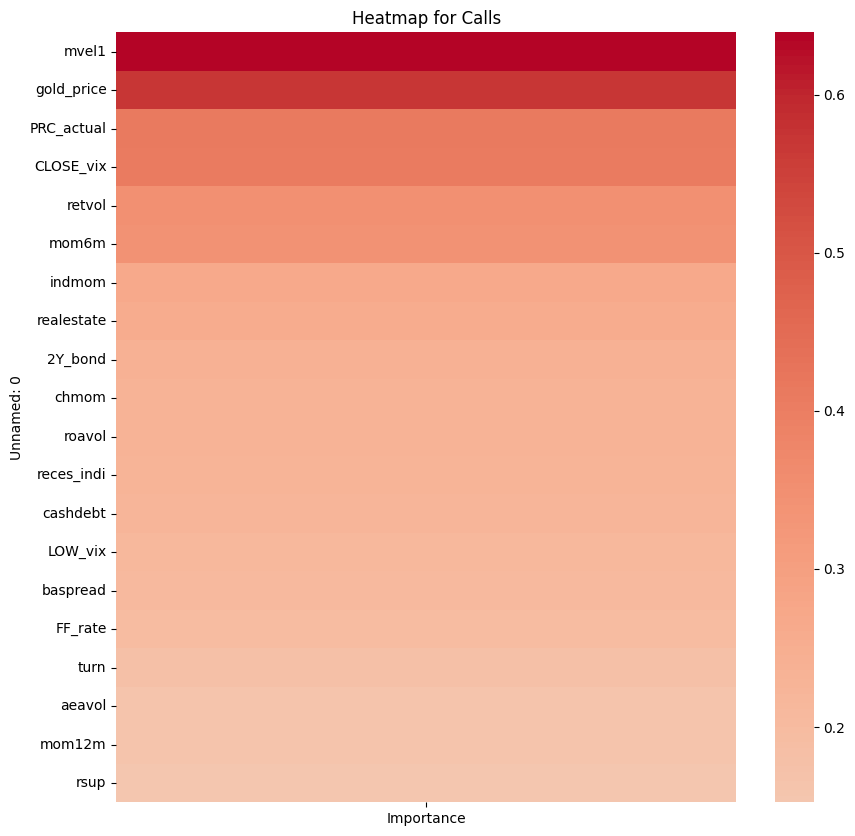

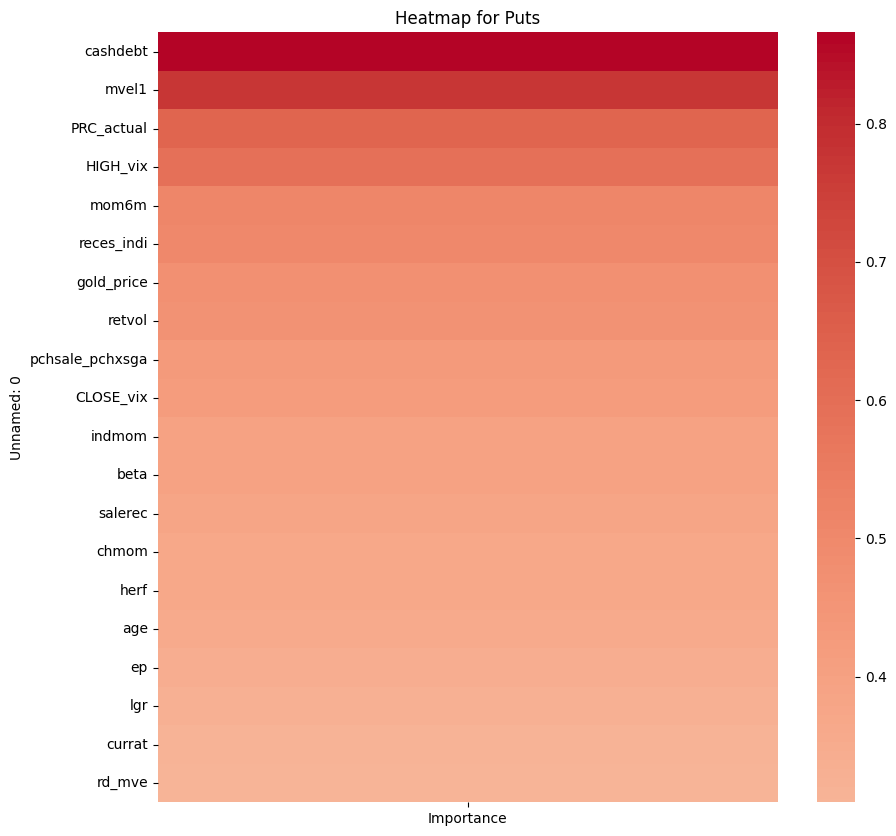

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the data
df_call = pd.read_csv('/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_call.csv')
df_put = pd.read_csv('/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features_put.csv')

# Assuming the DataFrame has columns 'feature' and 'weight'
# Sort the DataFrame by weight
df_call_sorted = df_call.sort_values(by='Importance', ascending=False)
df_put_sorted = df_put.sort_values(by='Importance', ascending=False)

# Create the heatmaps
plt.figure(figsize=(10, 10))
plt.title('Heatmap for Calls')
sns.heatmap(df_call_sorted.set_index('Unnamed: 0'), cmap='coolwarm', center=0)
plt.show()

plt.figure(figsize=(10, 10))
plt.title('Heatmap for Puts')
sns.heatmap(df_put_sorted.set_index('Unnamed: 0'), cmap='coolwarm', center=0)
plt.show()

In [ ]:
# import pandas as pd
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Load the data
# df = pd.read_csv('/Users/sbjpipers/Desktop/FinalThesisQF/FinalThesisQF/Data/Features/features.csv')

# # Separate the data for calls and puts
# df_calls = df[df['cp_flag'] == 'C']
# df_puts = df[df['cp_flag'] == 'P']

# # Group the data by ticker, m_category, and maturity_group, and calculate the mean of the numeric features
# df_calls_grouped = df_calls.groupby(['Ticker', 'm_category', 'maturity_group']).mean(numeric_only=True)
# df_puts_grouped = df_puts.groupby(['Ticker', 'm_category', 'maturity_group']).mean(numeric_only=True)

# # Create a heatmap for each ticker
# for ticker in df['Ticker'].unique():
#     # Calculate the mean of each feature and sort the features
#     df_calls_sorted = df_calls_grouped.loc[ticker].mean().sort_values(ascending=False)
#     df_puts_sorted = df_puts_grouped.loc[ticker].mean().sort_values(ascending=False)

#     # Create the heatmaps
#     plt.figure(figsize=(10, 10))
#     plt.title(f'Heatmap for {ticker} Calls')
#     sns.heatmap(df_calls_grouped.loc[ticker][df_calls_sorted.index].T, cmap='coolwarm', center=0)
#     plt.show()

#     plt.figure(figsize=(10, 10))
#     plt.title(f'Heatmap for {ticker} Puts')
#     sns.heatmap(df_puts_grouped.loc[ticker][df_puts_sorted.index].T, cmap='coolwarm', center=0)
#     plt.show()

Create standardised datasets for level, slope and curvature

In [ ]:
data_level = data[data.columns[:8].tolist() + level_features]
data_slope = data[data.columns[:8].tolist() + slope_features]
data_curve = data[data.columns[:8].tolist() + curve_features]

data_level.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_level_standardized.csv', index=True)
data_curve.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_curve_standardized.csv', index=True)
data_slope.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_slope_standardized.csv', index=True)

NameError: name 'level_features' is not defined

In [ ]:
data = pd.read_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_standardized_selection10.csv')
data.index = data["date"]
data.index = pd.to_datetime(data.index)
data.drop(columns=["date"], inplace=True)

data_level = data[data.columns[:8].tolist() + level_features.tolist()]
data_slope = data[data.columns[:8].tolist() + slope_features.tolist()]
data_curve = data[data.columns[:8].tolist() + curve_features.tolist()]

# data_level.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_level_standardized_dum_20.csv', index=True)
# data_curve.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_curve_standardized_dum_20.csv', index=True)
# data_slope.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_slope_standardized_dum_20.csv', index=True)

# data_level.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_level_standardized_pp_nosic.csv', index=True)
# data_curve.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_curve_standardized_pp_nosic.csv', index=True)
# data_slope.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_slope_standardized_pp_nosic.csv', index=True)

data_level.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_level_standardized_selection10.csv', index=True)
data_curve.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_curve_standardized_selection10.csv', index=True)
data_slope.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_slope_standardized_selection10.csv', index=True)

Create mapped datasets for level, slope and curvature

In [ ]:
data = pd.read_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_mapped.csv')
data.index = data["date"]
data.index = pd.to_datetime(data.index)
data.drop(columns=["date"], inplace=True)

data_level = data[data.columns[:8].tolist() + level_features]
data_slope = data[data.columns[:8].tolist() + slope_features]
data_curve = data[data.columns[:8].tolist() + curve_features]

data_level.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_level_mapped.csv', index=True)
data_curve.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_curve_mapped.csv', index=True)
data_slope.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_slope_mapped.csv', index=True)

In [ ]:
# data = pd.read_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_mapped_dum.csv')
# data = pd.read_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_mapped_pp_nosic.csv')
data = pd.read_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_mapped_selection10.csv')
data.index = data["date"]
data.index = pd.to_datetime(data.index)
data.drop(columns=["date"], inplace=True)

data_level = data[data.columns[:8].tolist() + level_features.tolist()]
data_slope = data[data.columns[:8].tolist() + slope_features.tolist()]
data_curve = data[data.columns[:8].tolist() + curve_features.tolist()]

# data_level.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_level_mapped_dum20.csv', index=True)
# data_curve.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_curve_mapped_dum20.csv', index=True)
# data_slope.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_slope_mapped_dum20.csv', index=True)

# data_level.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_level_mapped_pp_nosic.csv', index=True)
# data_curve.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_curve_mapped_pp_nosic.csv', index=True)
# data_slope.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_slope_mapped_pp_nosic.csv', index=True)

data_level.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_level_mapped_selection10.csv', index=True)
data_curve.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_curve_mapped_selection10.csv', index=True)
data_slope.to_csv('/content/drive/MyDrive/Msc Thesis/code/data/Low resolution/data_slope_mapped_selection10.csv', index=True)

In [ ]:
data_level.head()

In [ ]:
data_slope.head()

In [ ]:
data_curve.head()